In [ ]:
import os
import sys
import itertools
import math
import logging
import json
import re
import random
from collections import OrderedDict

import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.lines as lines
from matplotlib.patches import Polygon
import cv2

%matplotlib inline

In [ ]:
from mrcnn import utils
from mrcnn import visualize
from mrcnn.visualize import display_images
import mrcnn.model as modellib
from mrcnn.model import log

In [ ]:
# Root directory of the project
ROOT_DIR = os.path.abspath('C:/DEV/STUDY/maskrcnn/Mask_RCNN')

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn.config import Config
from mrcnn import model as modellib, utils
from mrcnn.visualize import display_instances

In [ ]:
class CustomDataset(utils.Dataset):

    def load_custom(self, dataset_dir, subset):
        """Load a subset of the Custom dataset.
        dataset_dir: Root directory of the dataset.
        subset: Subset to load: train or val
        """
        # 클래스 id와 클래스명 등록은 Dataset의 add_class()를 이용. 
        self.add_class("oring", 1, "ok")
        self.add_class("oring", 2, "block")
        self.add_class("oring", 3, "inner")
        self.add_class("oring", 4, "outer")
        self.add_class("oring", 5, "scar")
        self.add_class("oring", 6, "tear")

        # train또는 val 용도의 Dataset 생성만 가능. 
        assert subset in ["train", "val", 'test']
        dataset_dir = os.path.join(dataset_dir, subset)
        
        # json 형태의 annotation을 로드하고 파싱. 
        annotations = json.load(open(os.path.join(dataset_dir, "via_region_data.json")))
        annotations = list(annotations.values())  # don't need the dict keys
        
        annotations = [a for a in annotations if a['regions']]

        # Add images
        for a in annotations:
#             print(a)
            # Get the x, y coordinaets of points of the polygons that make up
            # the outline of each object instance. There are stores in the
            # shape_attributes (see json format above)
            polygons = [r['shape_attributes'] for r in a['regions'].values()] 
            objects = [s['region_attributes']['Class'] for s in a['regions'].values()]
            print("objects:",objects)
            name_dict = {"ok": 1,"block": 2,"inner": 3,"outer": 4, 'scar' : 5, 'tear' : 6}
            # key = tuple(name_dict)
            num_ids = [name_dict[a] for a in objects]

            # load_mask() needs the image size to convert polygons to masks.
            # Unfortunately, VIA doesn't include it in JSON, so we must read
            # the image. This is only managable since the dataset is tiny.
            image_path = os.path.join(dataset_dir, a['filename'])
            image = skimage.io.imread(image_path)
            height, width = image.shape[:2]

            self.add_image(
                "oring",
                image_id=a['filename'],  # use file name as a unique image id
                path=image_path,
                width=width, height=height,
                polygons=polygons,
                num_ids=num_ids)

    def load_mask(self, image_id):
        """Generate instance masks for an image.
       Returns:
        masks: A bool array of shape [height, width, instance count] with
            one mask per instance.
        class_ids: a 1D array of class IDs of the instance masks.
        """
        # If not a balloon dataset image, delegate to parent class.
        image_info = self.image_info[image_id]
        if image_info["source"] != "oring":
            return super(self.__class__, self).load_mask(image_id)

        # Convert polygons to a bitmap mask of shape
        # [height, width, instance_count]
        info = self.image_info[image_id]
        if info["source"] != "oring":
            return super(self.__class__, self).load_mask(image_id)
        num_ids = info['num_ids']
        mask = np.zeros([info["height"], info["width"], len(info["polygons"])],
                        dtype=np.uint8)
        for i, p in enumerate(info["polygons"]):
            # Get indexes of pixels inside the polygon and set them to 1
        	rr, cc = skimage.draw.polygon(p['all_points_y'], p['all_points_x'])

        	mask[rr, cc, i] = 1

        # Return mask, and array of class IDs of each instance. Since we have
        # one class ID only, we return an array of 1s
        # Map class names to class IDs.
        num_ids = np.array(num_ids, dtype=np.int32)
        return mask, num_ids
    
    '''def image_reference(self, image_id):
        """Return the path of the image."""
        info = self.image_info[image_id]
        if info["source"] == "balloon":
            return info["path"]
        else:
            super(self.__class__, self).image_reference(image_id)
    '''

In [ ]:
import skimage

Custom_DATA_DIR = 'C:/DEV/STUDY/maskrcnn/Oring_annot_coco'

# Training dataset.
dataset_train = CustomDataset()
dataset_train.load_custom(Custom_DATA_DIR, "train")
dataset_train.prepare()

# Validation dataset
dataset_val = CustomDataset()
dataset_val.load_custom(Custom_DATA_DIR, "val")
dataset_val.prepare()

objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
ob

objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects:

objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: ['scar']
objects: [

In [ ]:
from mrcnn.config import Config

TRAIN_IMAGE_CNT = len(dataset_train.image_info)
VALID_IMAGE_CNT = len(dataset_val.image_info)

class CustomConfig(Config):
    """Configuration for training on the toy  dataset.
    Derives from the base Config class and overrides some values.
    """
    # Give the configuration a recognizable name
    NAME = "oring"

    # Number of classes (including background)
    NUM_CLASSES = 1 + 1 + 5  # Background + OK + NG

    # Skip detections with < 90% confidence
    DETECTION_MIN_CONFIDENCE = 0.9
    
    # We use a GPU with 12GB memory, which can fit two images.
    # Adjust down if you use a smaller GPU.
    IMAGES_PER_GPU = 1
    
    # 추가.
    GPU_COUNT = 1

    # 원본에서 수정.
    #STEPS_PER_EPOCH = TRAIN_IMAGE_CNT  // IMAGES_PER_GPU
    #VALIDATION_STEPS = VALID_IMAGE_CNT  // IMAGES_PER_GPU
    
    # 원본 STEPS_PER_EPOCH
    STEPS_PER_EPOCH = TRAIN_IMAGE_CNT  // IMAGES_PER_GPU
    VALIDATION_STEPS = VALID_IMAGE_CNT  // IMAGES_PER_GPU

    #BACKBONE = 'resnet101'
    
# config 설정. 
train_config = CustomConfig()
train_config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.9
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                19
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

In [ ]:
import mrcnn.model as modellib
from mrcnn.model import log

custom_model = modellib.MaskRCNN(mode="training", config=train_config, model_dir='C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight')

# COCO 데이터 세트로 pretrained 된 모델을 이용하여 초기 weight값 로딩. 
COCO_MODEL_PATH = "C:/DEV/STUDY/maskrcnn/Mask_RCNN/mask_rcnn_coco.h5"
custom_model.load_weights(COCO_MODEL_PATH, by_name=True, exclude=["mrcnn_class_logits", "mrcnn_bbox_fc","mrcnn_bbox", "mrcnn_mask"])

In [ ]:
'''
데이터 세트가 작고,단 하나의 클래스임. 
pretrained 된 Coco 데이터 세트로 초기 weight 설정되었기에 RPN과 classifier만 학습해도 모델 성능은 큰 영향이 없을 거라 예상
all: All the layers
3+: Train Resnet stage 3 and up
4+: Train Resnet stage 4 and up
5+: Train Resnet stage 5 and up
'''
print("Training network heads")
custom_model.train(dataset_train, dataset_val,
            learning_rate=train_config.LEARNING_RATE,
            epochs=30,
            layers='heads')

Training network heads

Starting at epoch 0. LR=0.001

Checkpoint Path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight\oring20221107T2346\mask_rcnn_oring_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv4  

C:\DEV\Util\Anaconda3\envs\maskrcnn\lib\site-packages\tensorflow\python\ops\gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Epoch 1/30
1202/1202 [==============================] - 806s 670ms/step - loss: 0.2226 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0564 - mrcnn_bbox_loss: 0.0630 - mrcnn_mask_loss: 0.0655 - val_loss: 0.1175 - val_rpn_class_loss: 8.6666e-04 - val_rpn_bbox_loss: 0.0223 - val_mrcnn_class_loss: 0.0360 - val_mrcnn_bbox_loss: 0.0179 - val_mrcnn_mask_loss: 0.0405
Epoch 2/30
1202/1202 [==============================] - 700s 582ms/step - loss: 0.0736 - rpn_class_loss: 7.9817e-04 - rpn_bbox_loss: 0.0166 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0184 - val_loss: 0.1329 - val_rpn_class_loss: 6.2579e-04 - val_rpn_bbox_loss: 0.0418 - val_mrcnn_class_loss: 0.0235 - val_mrcnn_bbox_loss: 0.0209 - val_mrcnn_mask_loss: 0.0460
Epoch 3/30
1202/1202 [==============================] - 682s 567ms/step - loss: 0.0519 - rpn_class_loss: 5.3798e-04 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0182 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0154 - val

Epoch 22/30
1202/1202 [==============================] - 559s 465ms/step - loss: 0.0119 - rpn_class_loss: 6.6846e-05 - rpn_bbox_loss: 0.0017 - mrcnn_class_loss: 0.0016 - mrcnn_bbox_loss: 9.7666e-04 - mrcnn_mask_loss: 0.0077 - val_loss: 0.0954 - val_rpn_class_loss: 6.0674e-05 - val_rpn_bbox_loss: 0.0083 - val_mrcnn_class_loss: 0.0035 - val_mrcnn_bbox_loss: 0.0062 - val_mrcnn_mask_loss: 0.0773
Epoch 23/30
1202/1202 [==============================] - 561s 467ms/step - loss: 0.0116 - rpn_class_loss: 5.7243e-05 - rpn_bbox_loss: 0.0016 - mrcnn_class_loss: 0.0015 - mrcnn_bbox_loss: 0.0010 - mrcnn_mask_loss: 0.0073 - val_loss: 0.1127 - val_rpn_class_loss: 4.4759e-05 - val_rpn_bbox_loss: 0.0071 - val_mrcnn_class_loss: 0.0025 - val_mrcnn_bbox_loss: 0.0056 - val_mrcnn_mask_loss: 0.0974
Epoch 24/30
1202/1202 [==============================] - 558s 465ms/step - loss: 0.0109 - rpn_class_loss: 4.9523e-05 - rpn_bbox_loss: 0.0015 - mrcnn_class_loss: 0.0013 - mrcnn_bbox_loss: 8.3098e-04 - mrcnn_mask_los

In [ ]:
class InferenceConfig(CustomConfig):
    # NAME은 학습모델과 동일한 명을 부여
    NAME='oring'
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
        
infer_config = InferenceConfig()
infer_config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.9
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                19
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

In [ ]:
# Inference를 위해 val Dataset 재로딩. 
dataset_val = CustomDataset()
dataset_val.load_custom(Custom_DATA_DIR, "val")
dataset_val.prepare()

dataset_test = CustomDataset()
dataset_test.load_custom(Custom_DATA_DIR, "test")
dataset_test.prepare()

print("Images: {}\nClasses: {}".format(len(dataset_val.image_ids), dataset_val.class_names))
print("Images: {}\nClasses: {}".format(len(dataset_test.image_ids), dataset_test.class_names))

objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['block']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['inner']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
objects: ['ok']
ob

In [ ]:
import pandas as pd
import glob
from mrcnn import model as modellib
from time import time

In [ ]:
labels_to_names = {0:'BG ', 1:'ok', 2:'block', 3:'inner', 4:'outer', 5:'scar', 6:'tear'}
weight_list = glob.glob('C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346/*.h5')
img_list = glob.glob('C:/DEV/STUDY/maskrcnn/test_data/crop/*.jpg')

In [ ]:
model = modellib.MaskRCNN(mode="inference", model_dir='C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight', config=infer_config)
weights_path = 'C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346/mask_rcnn_oring_0030.h5'
print('model weight path:', weights_path)
# 지정된 weight 파일명으로 모델에 로딩. 
model.load_weights(weights_path, by_name=True)

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346/mask_rcnn_oring_0030.h5
Re-starting from epoch 30


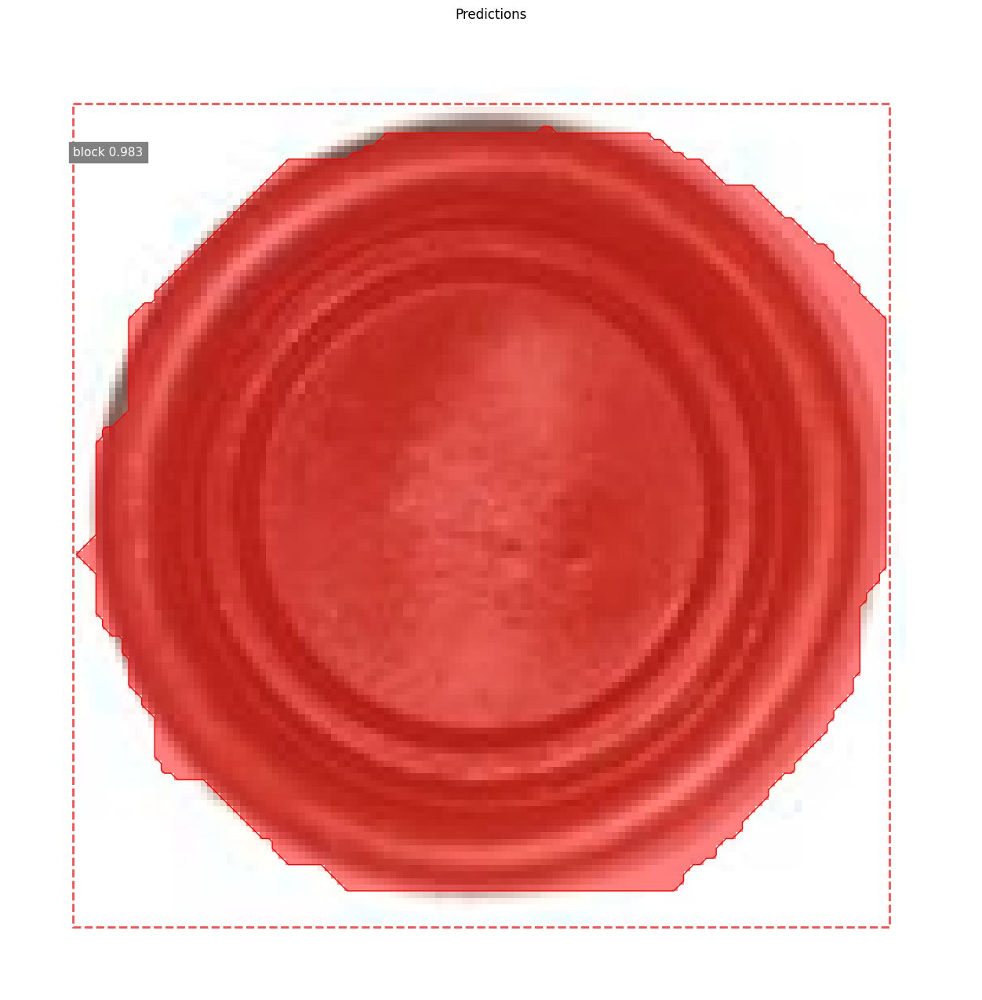


*** No instances to display *** 



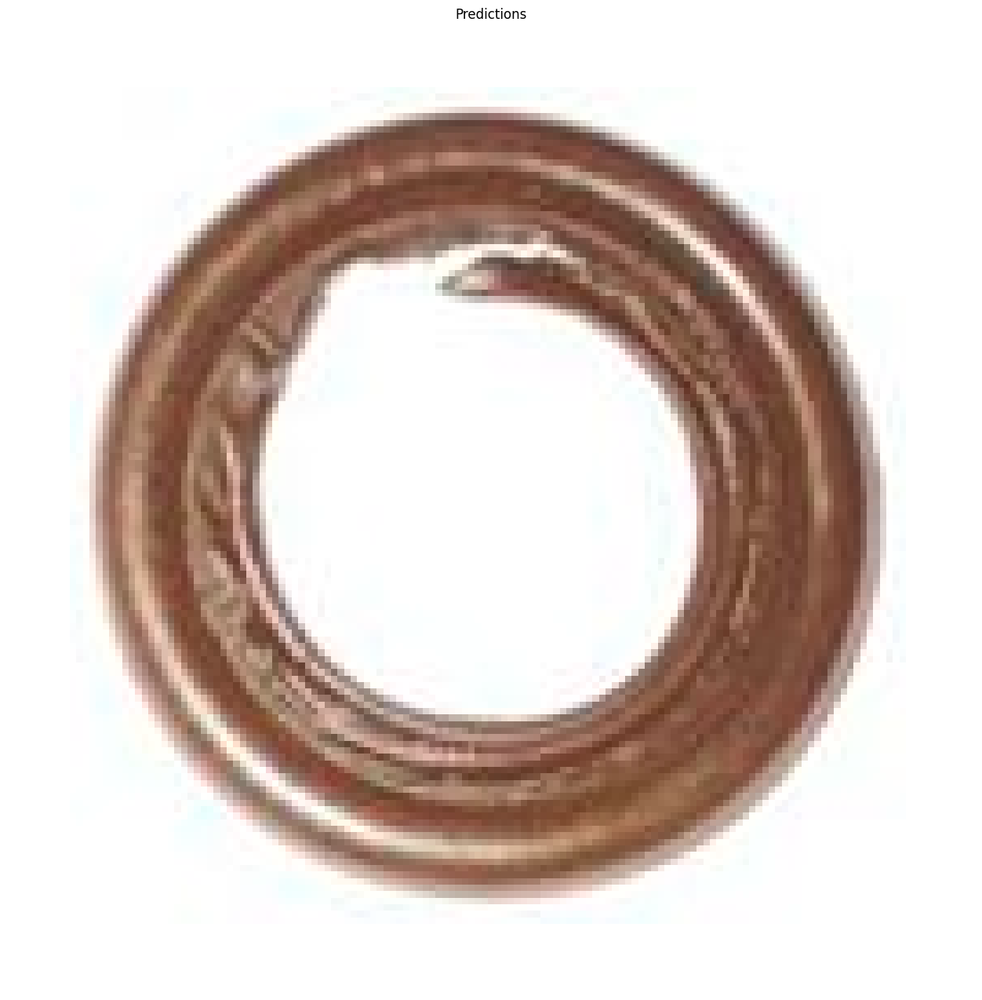

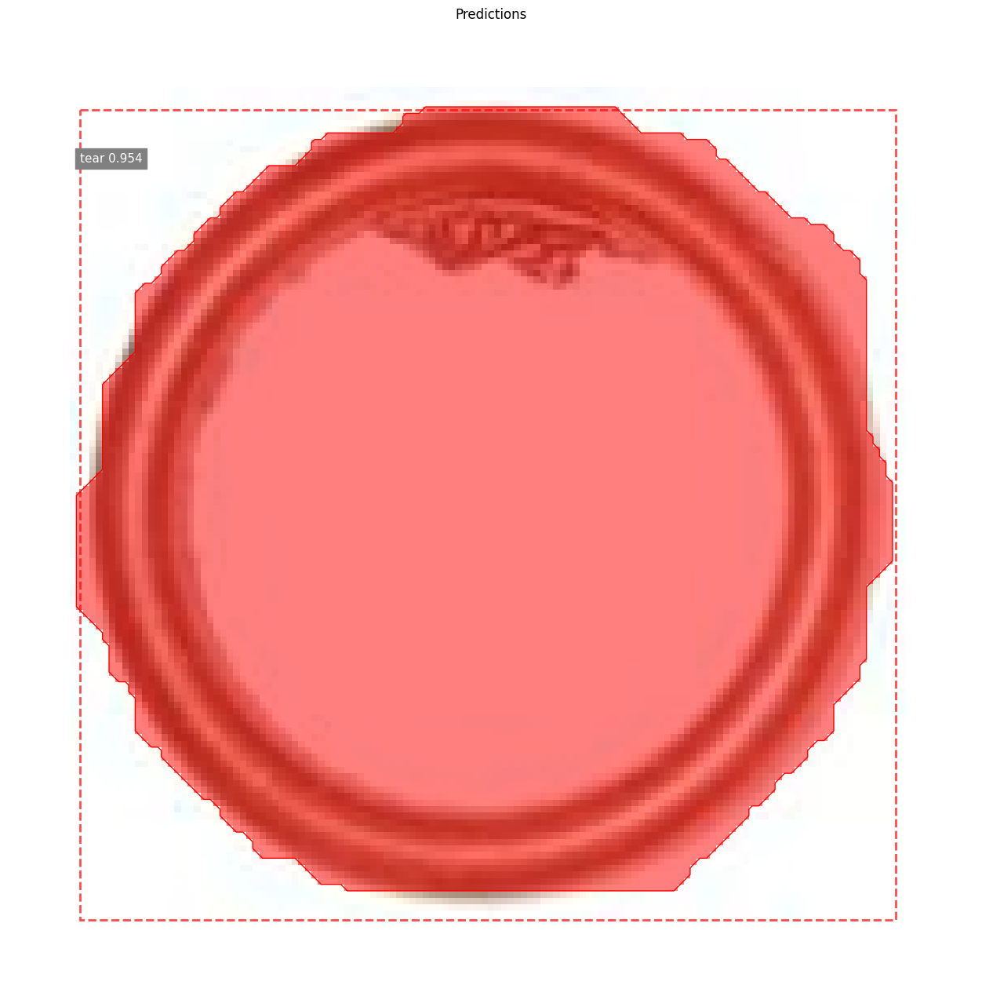


*** No instances to display *** 



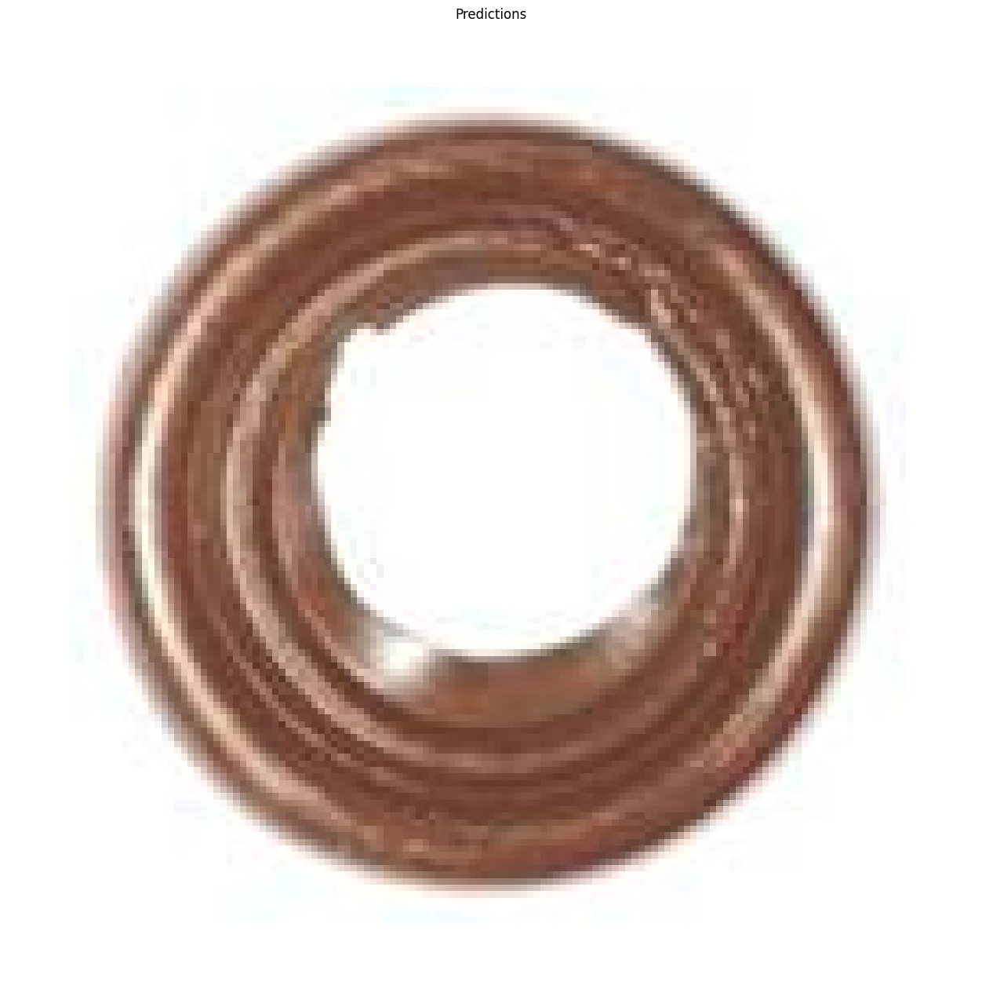


*** No instances to display *** 



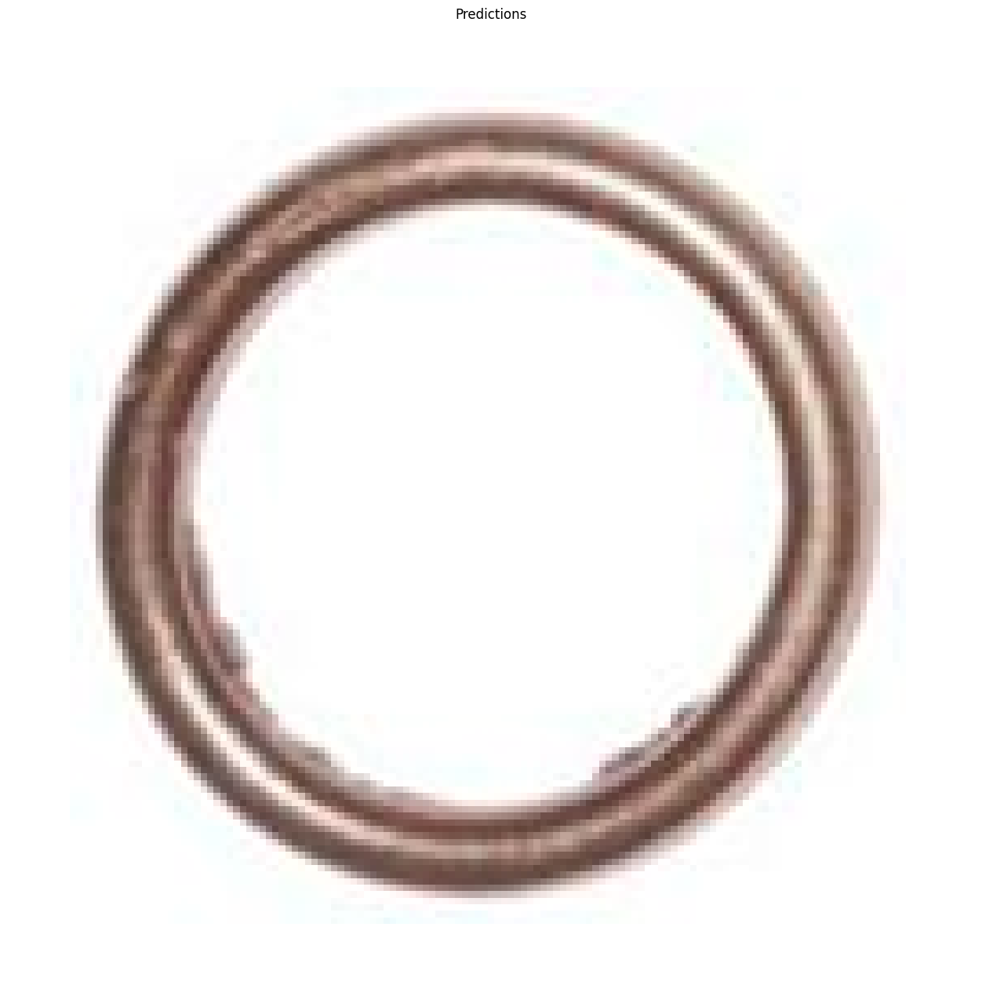


*** No instances to display *** 



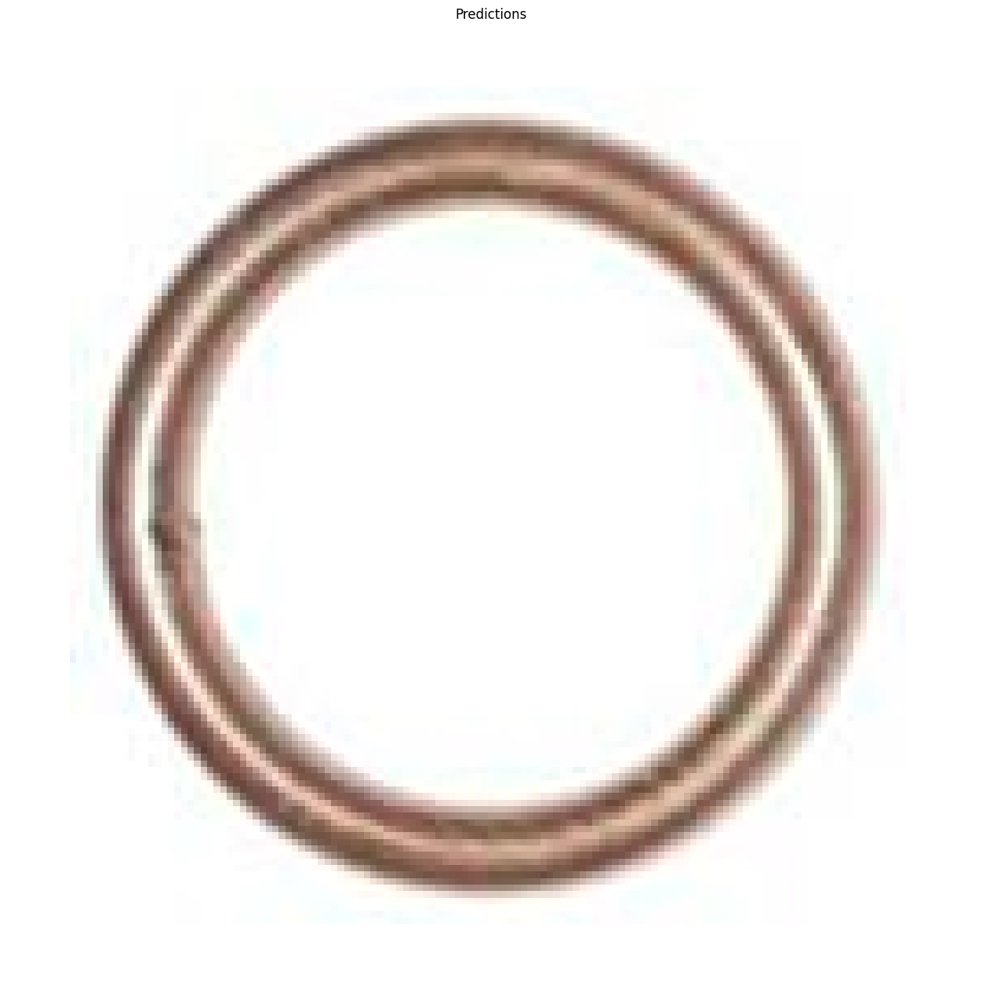

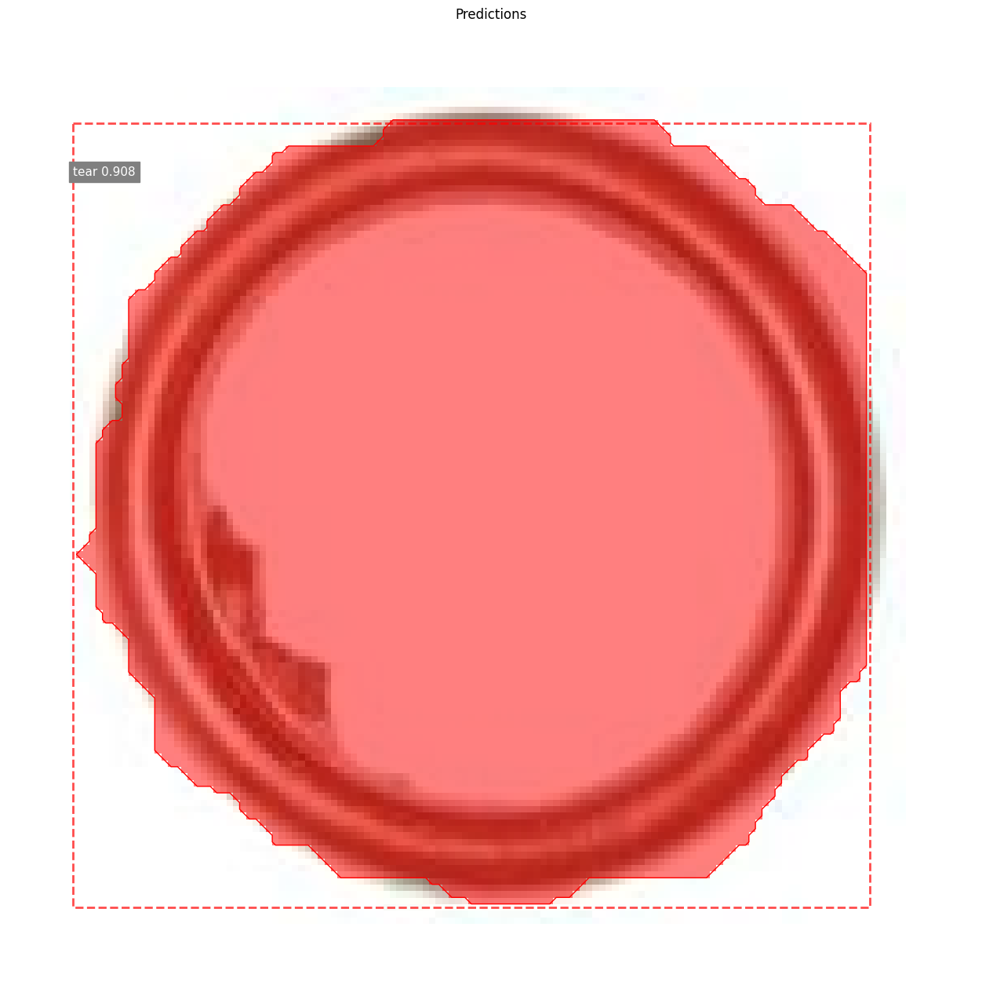


*** No instances to display *** 



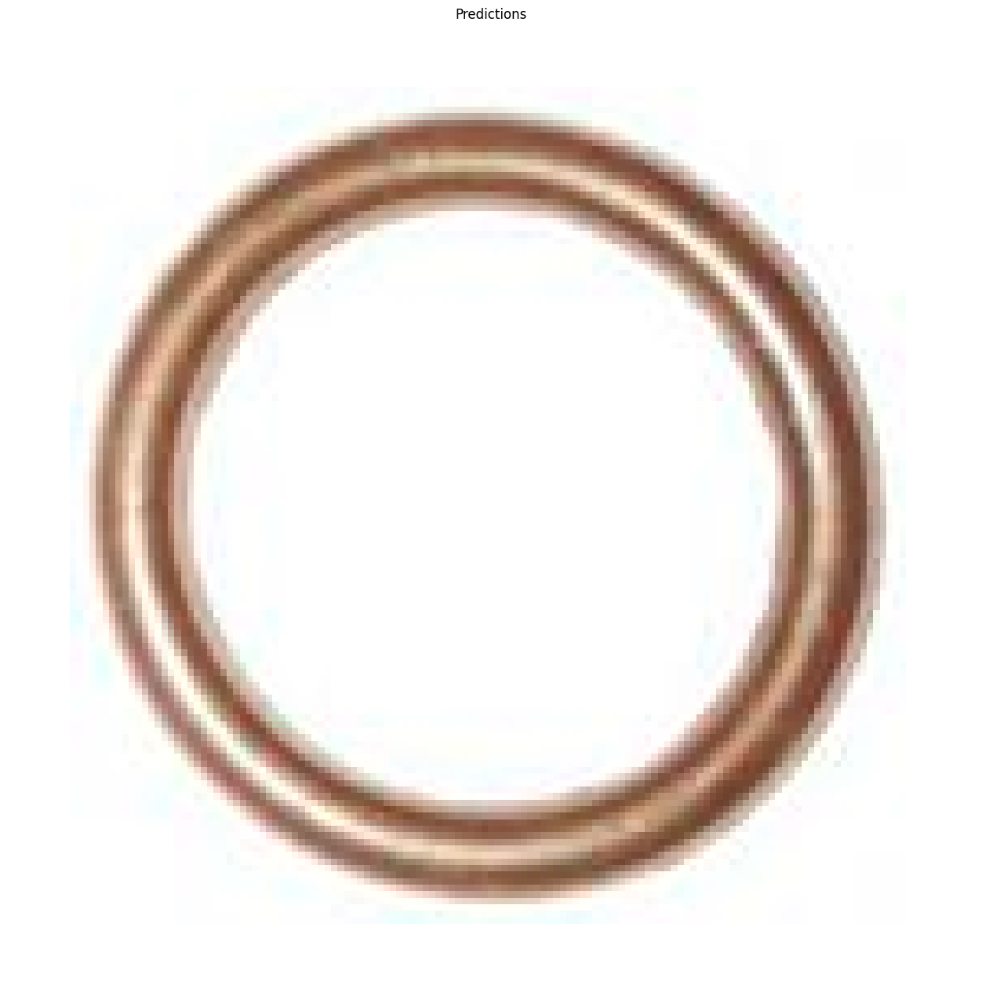

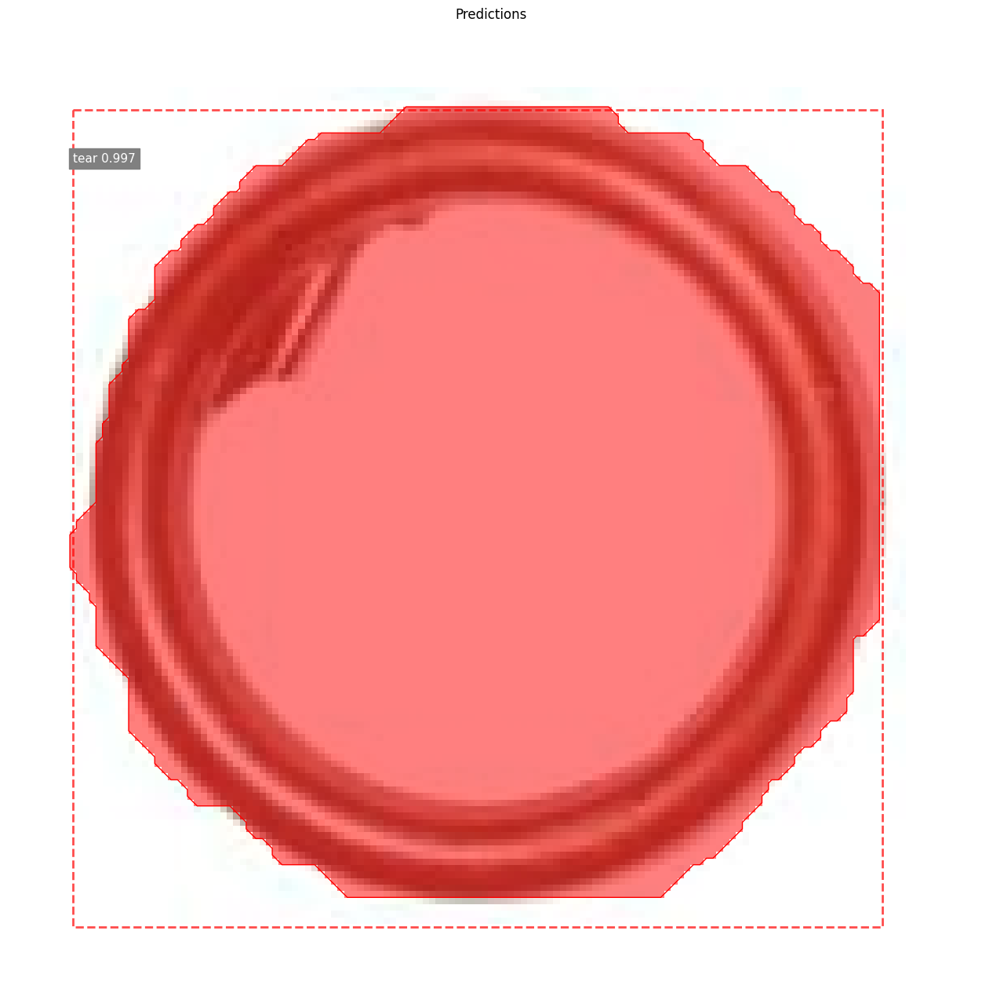

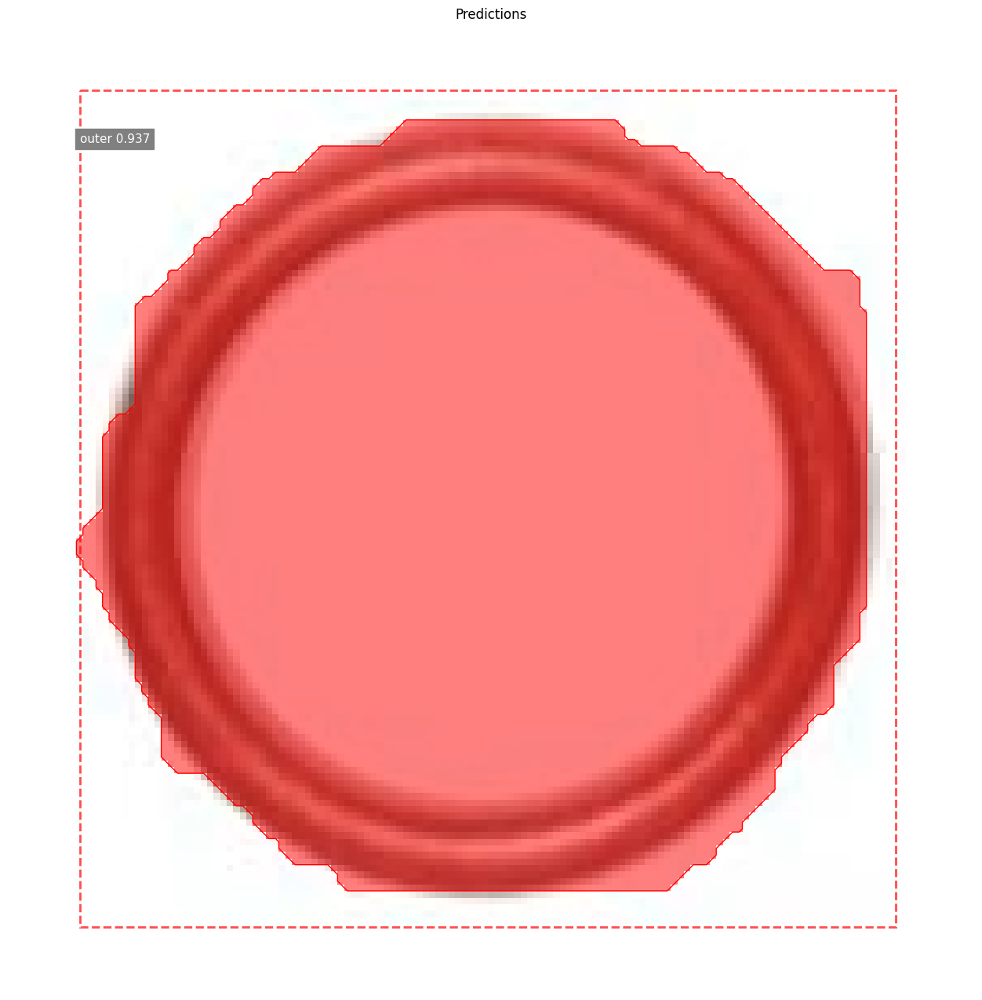

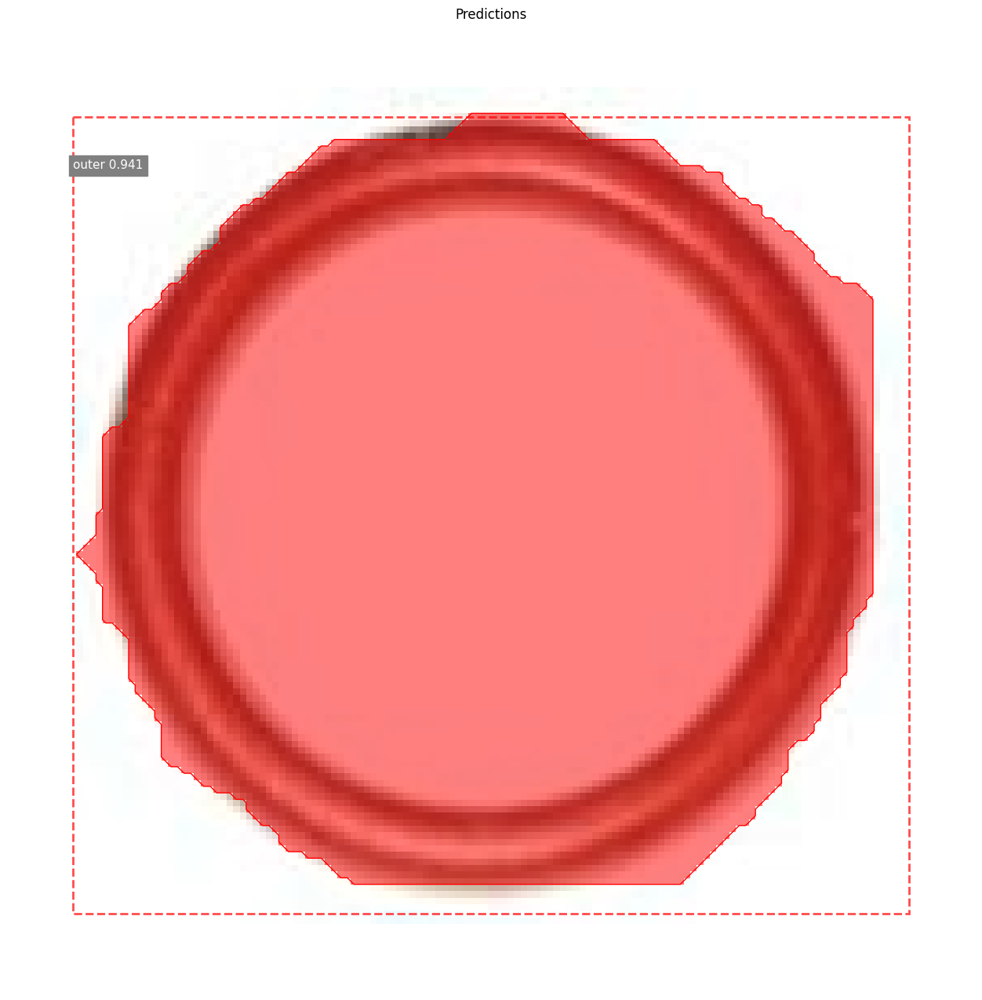


*** No instances to display *** 



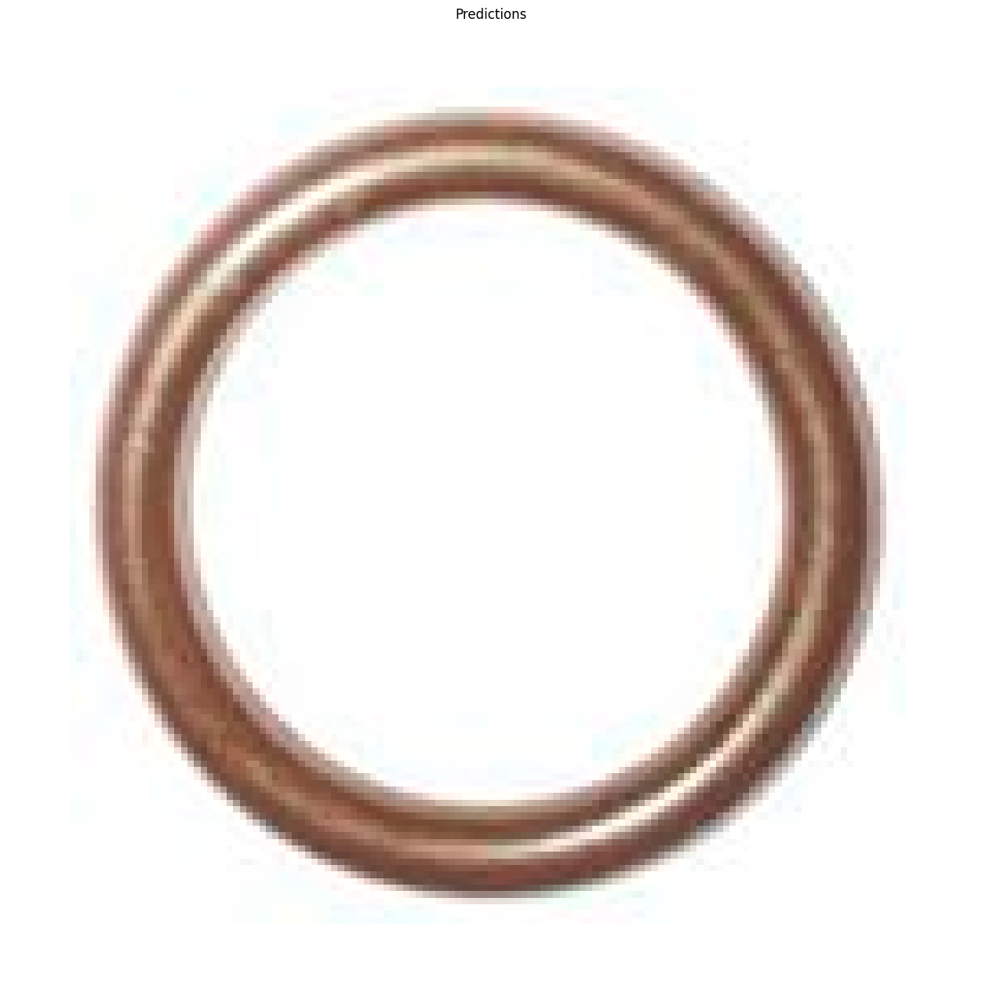

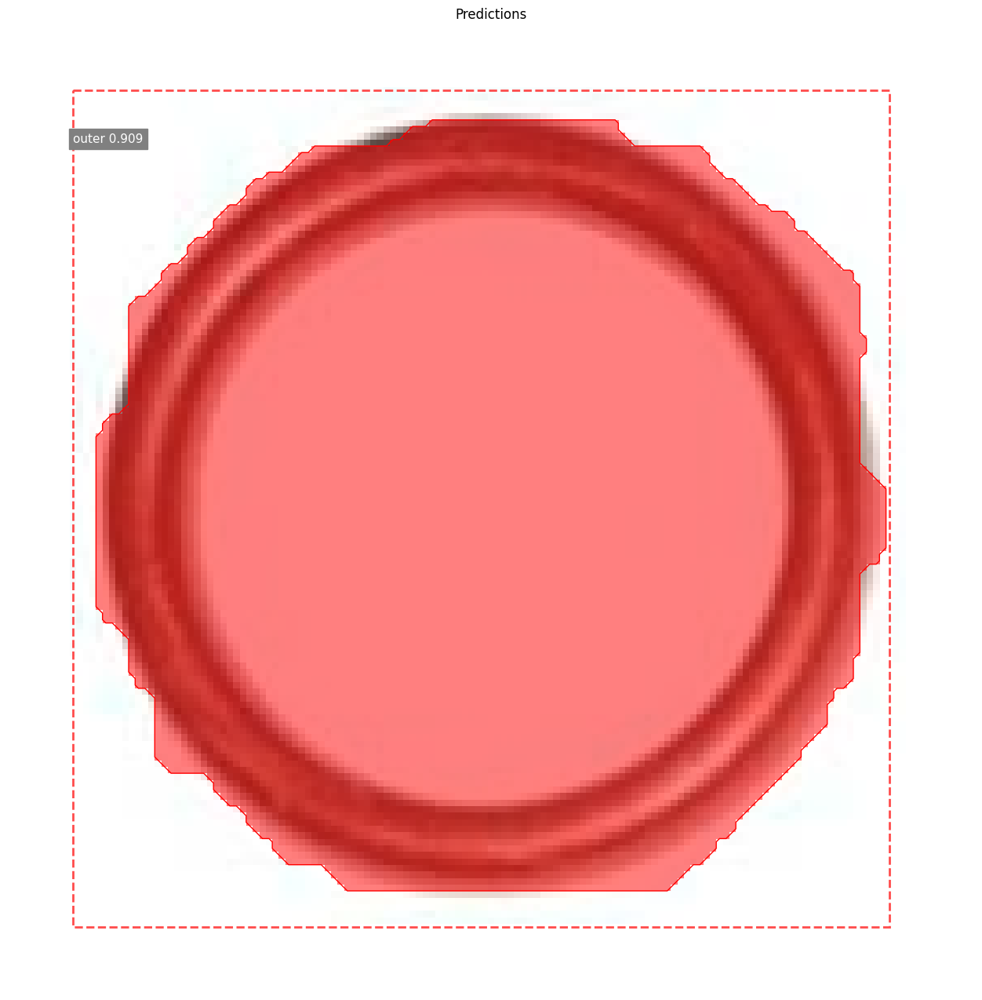


*** No instances to display *** 



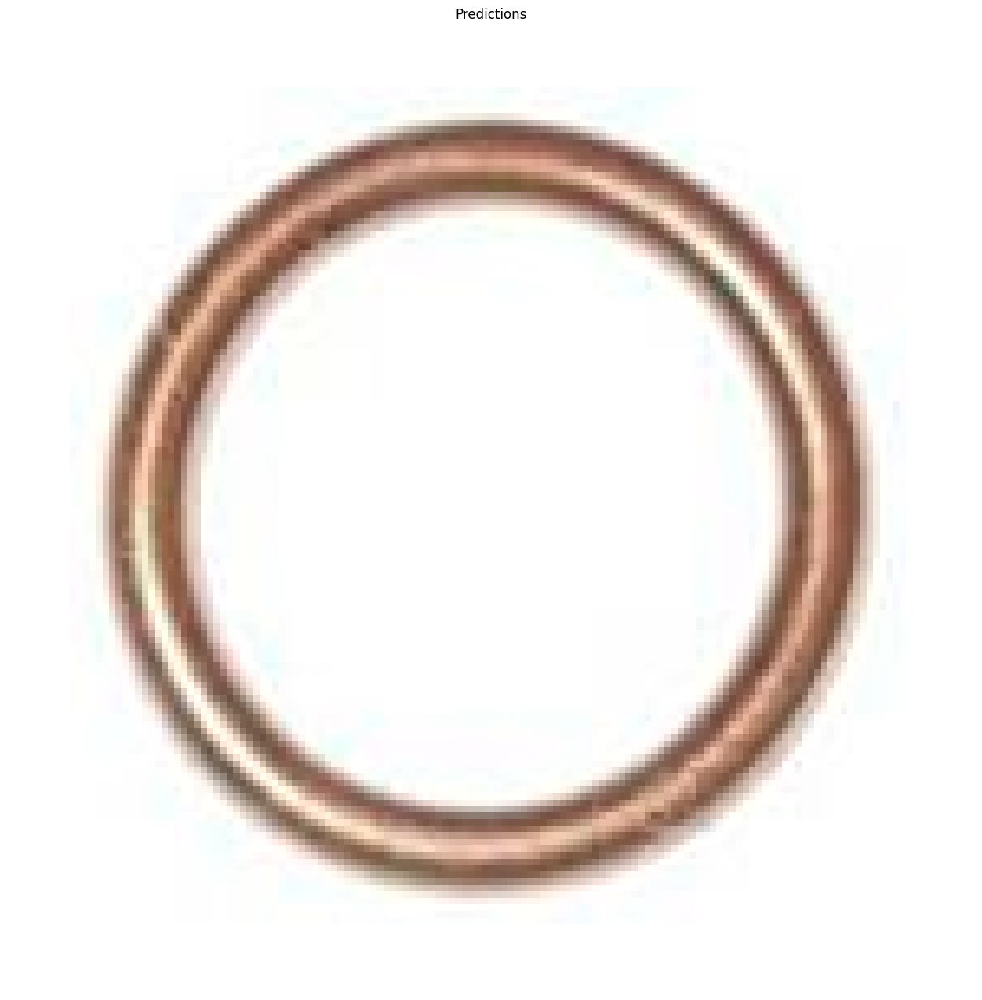

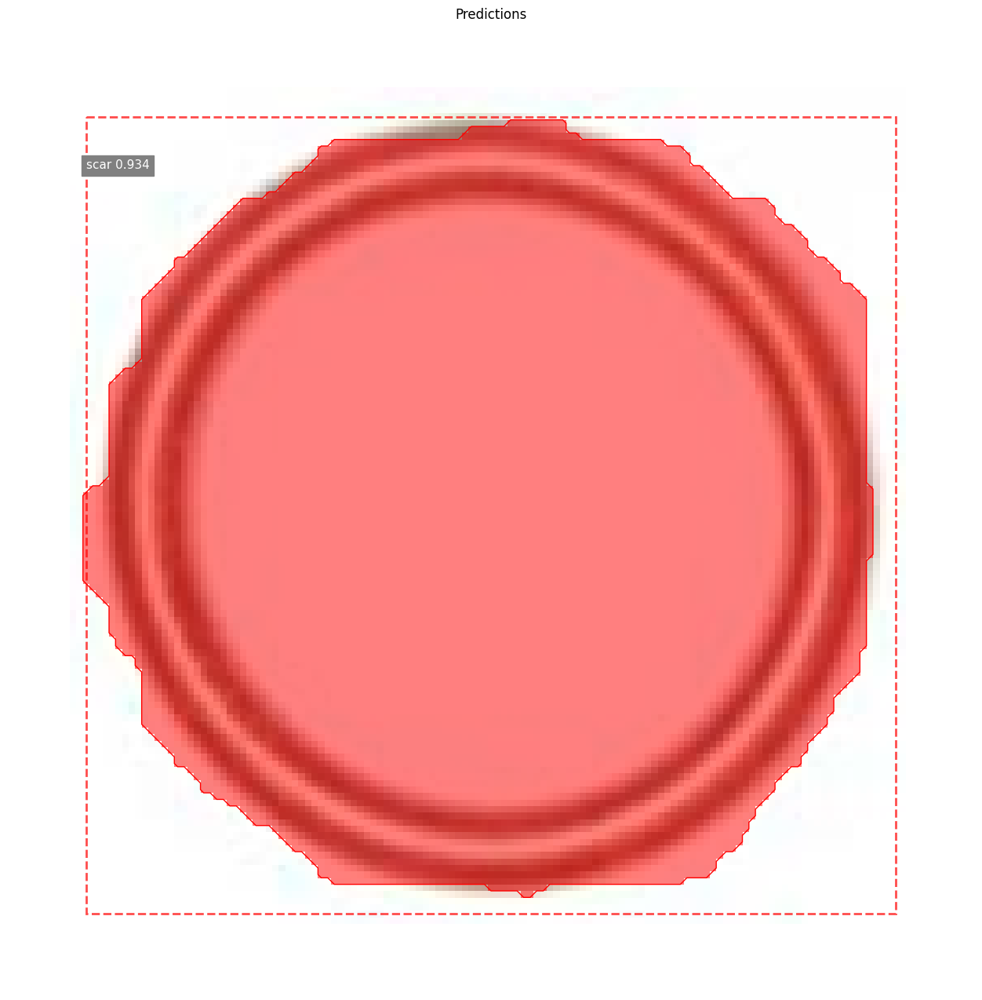

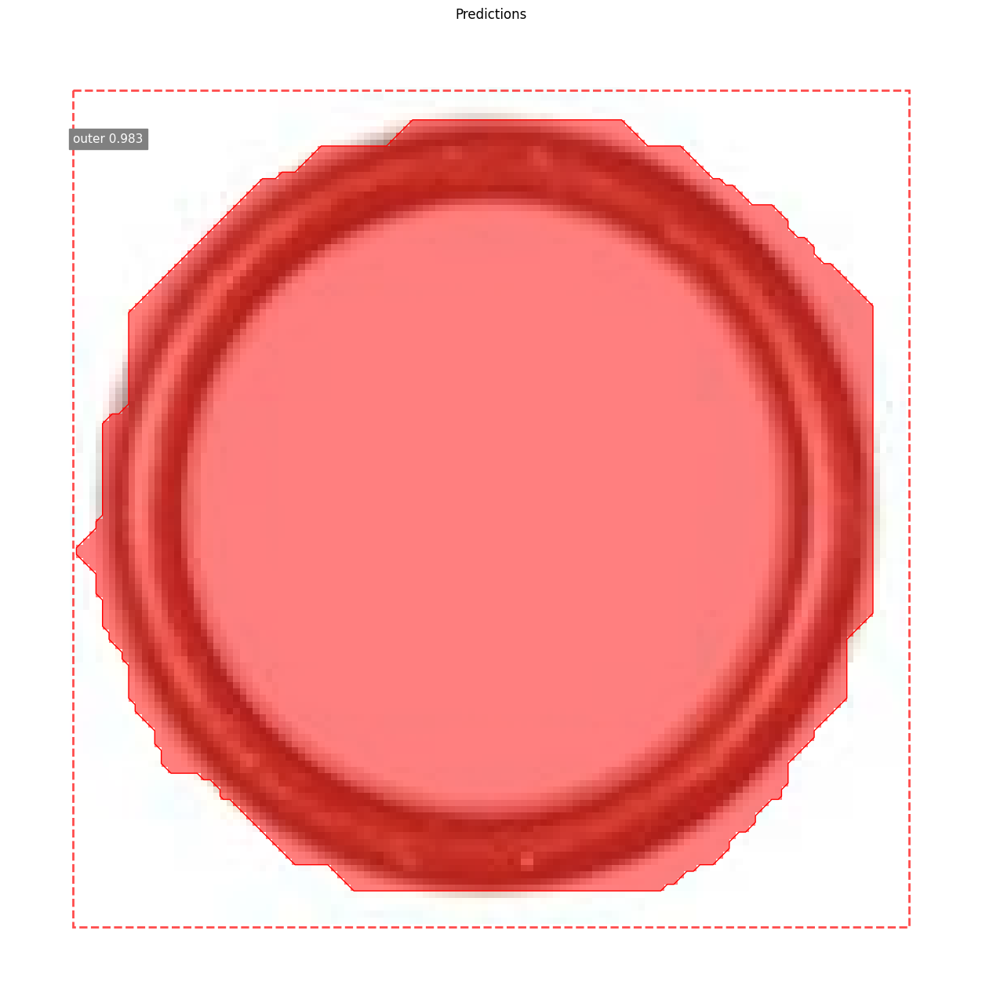

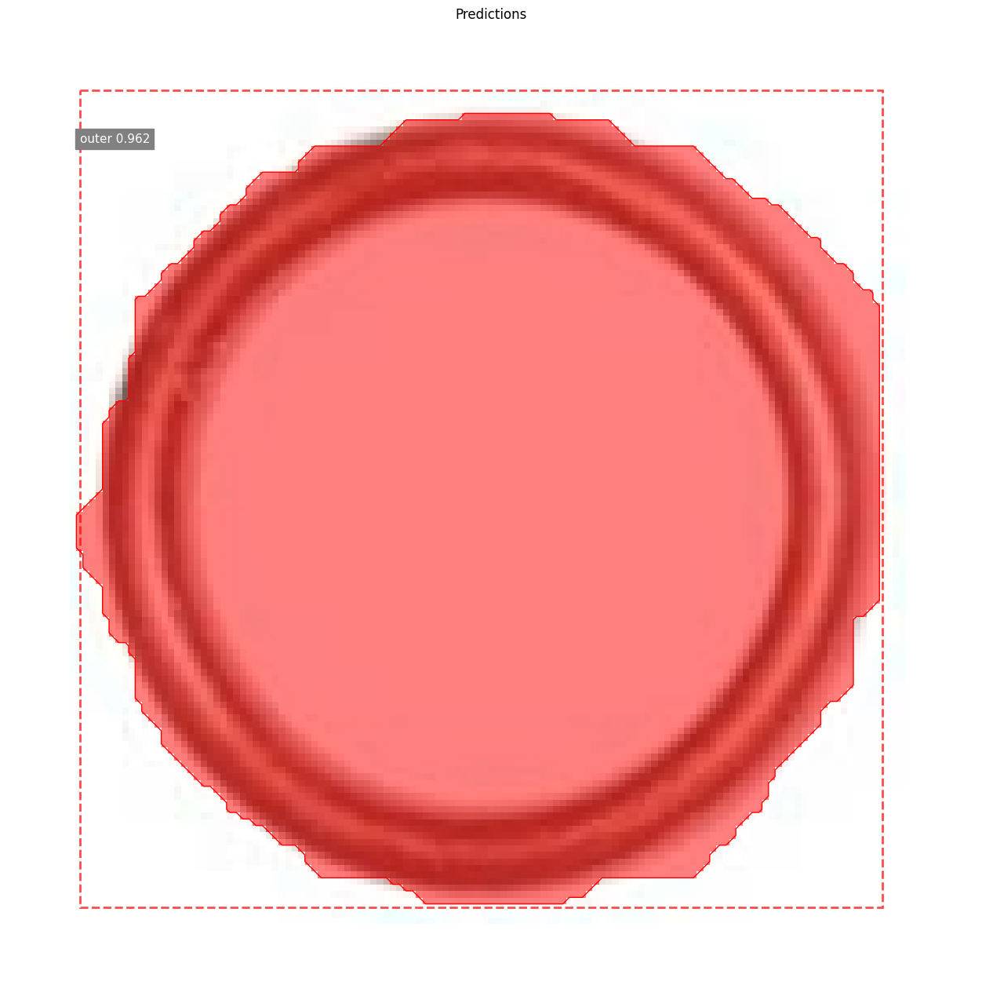

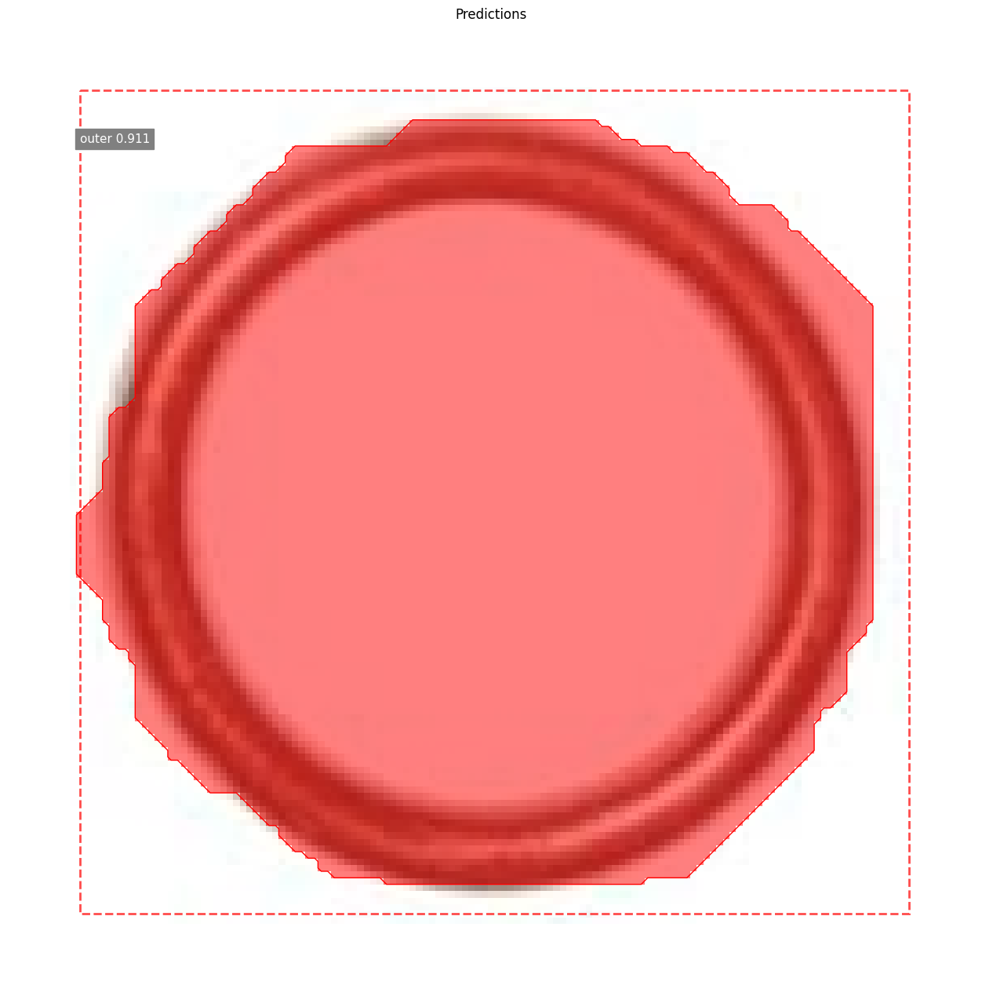


*** No instances to display *** 



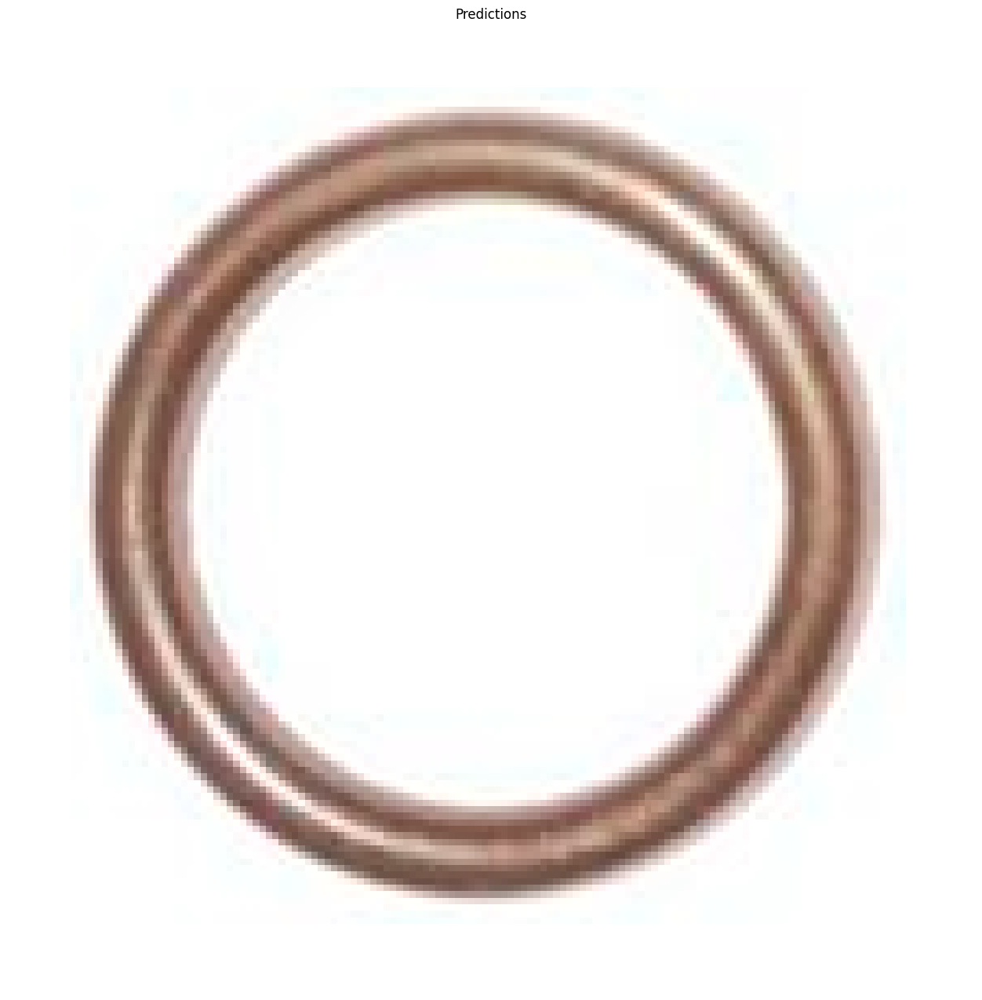

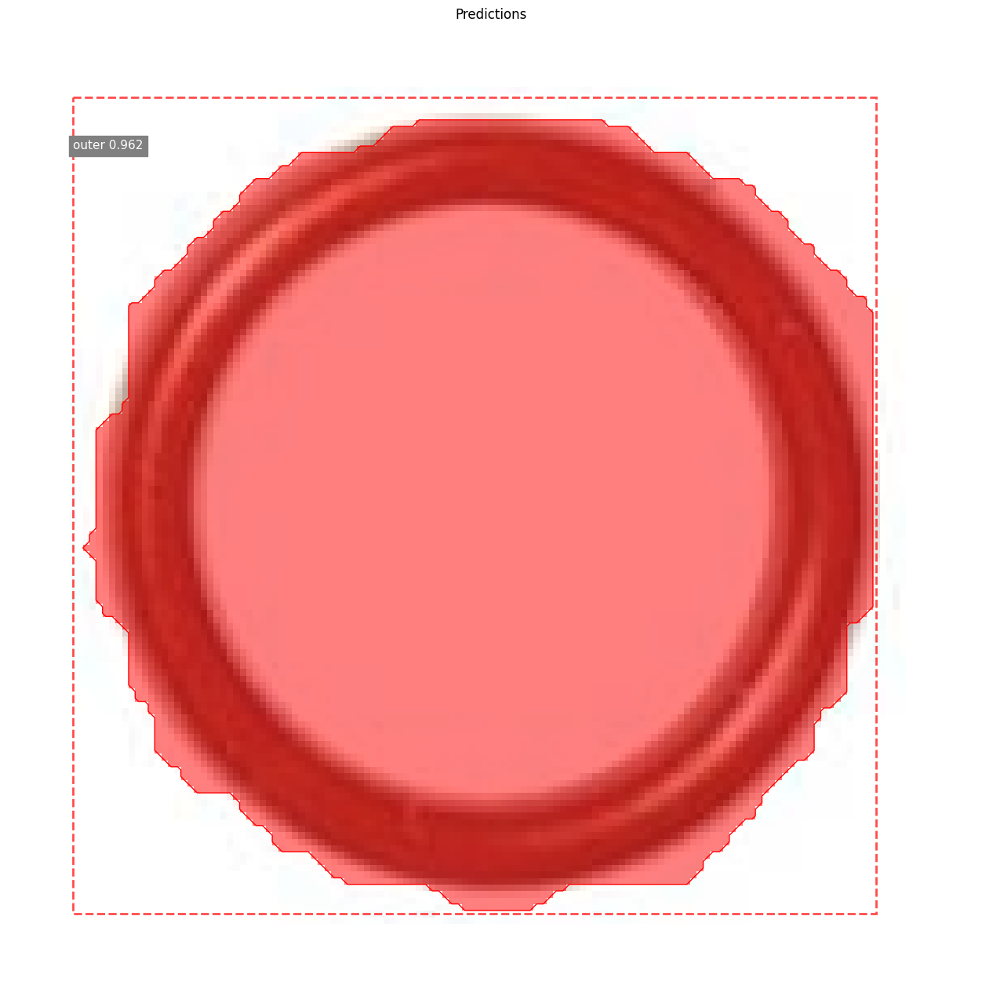

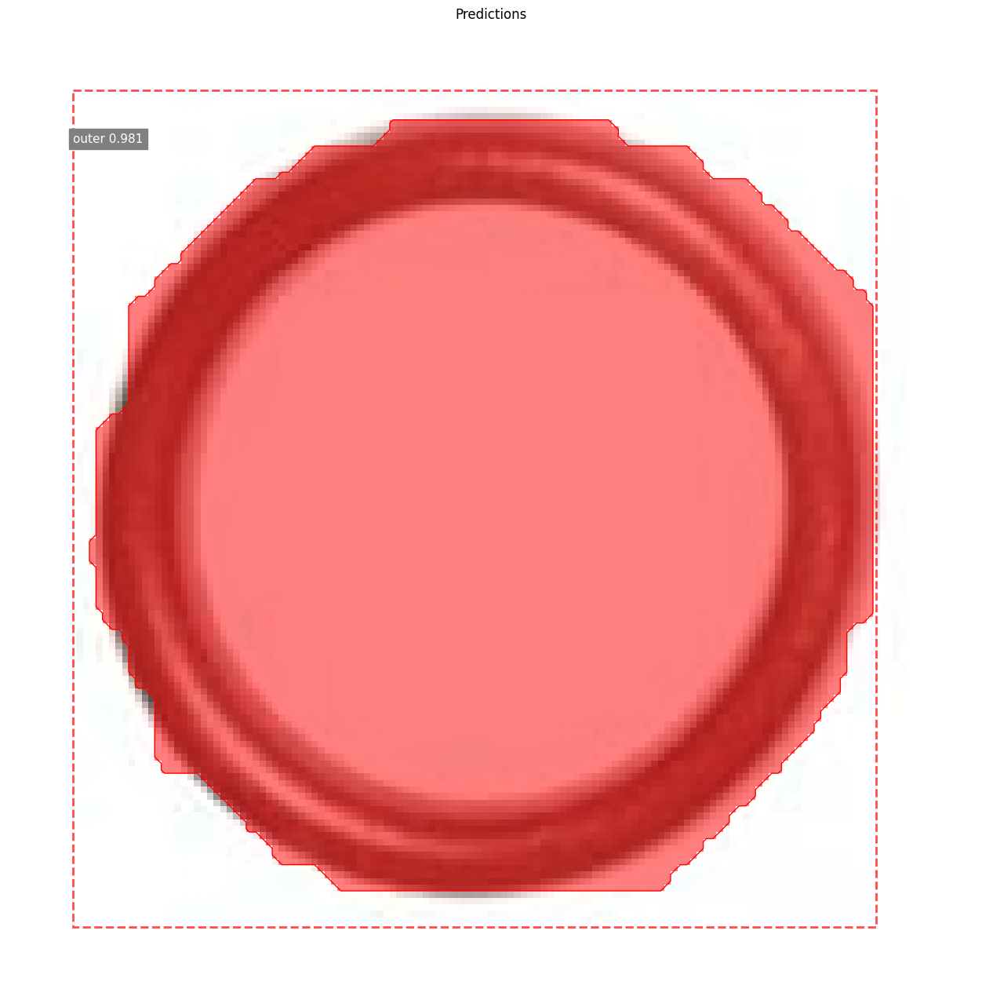

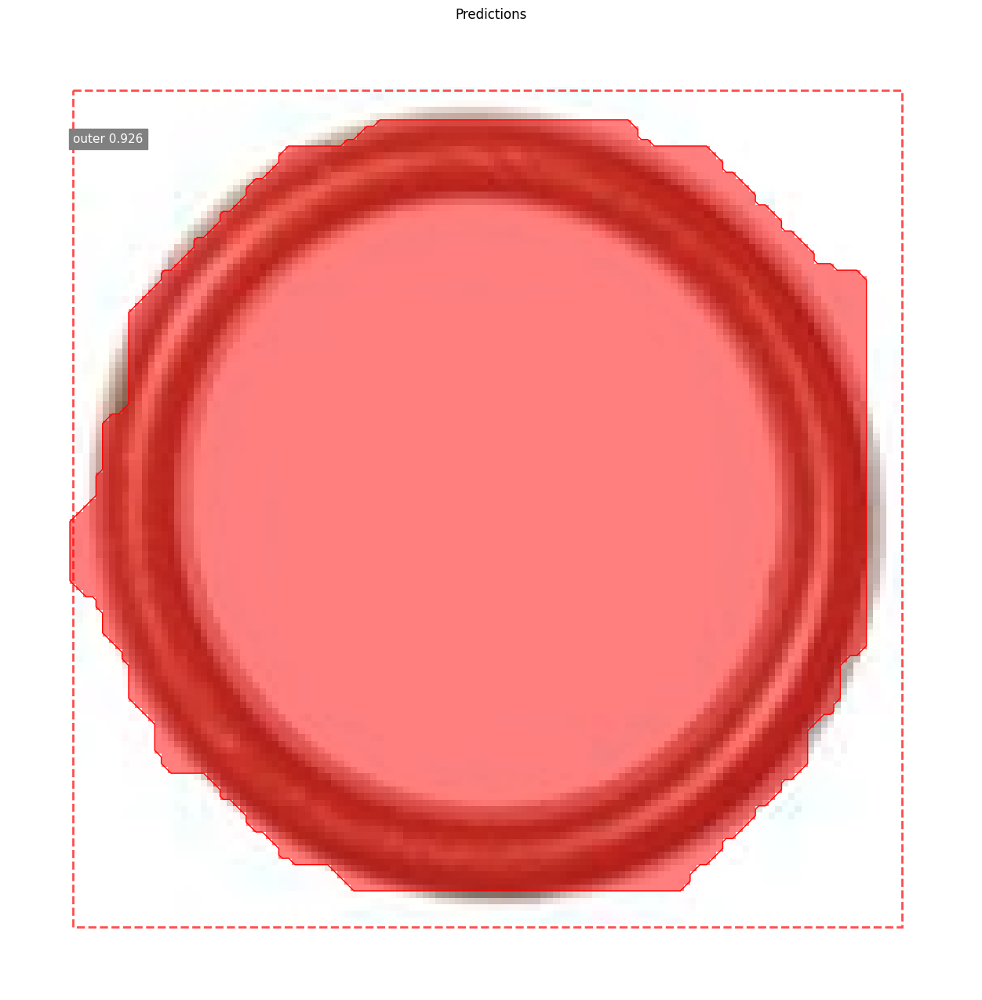

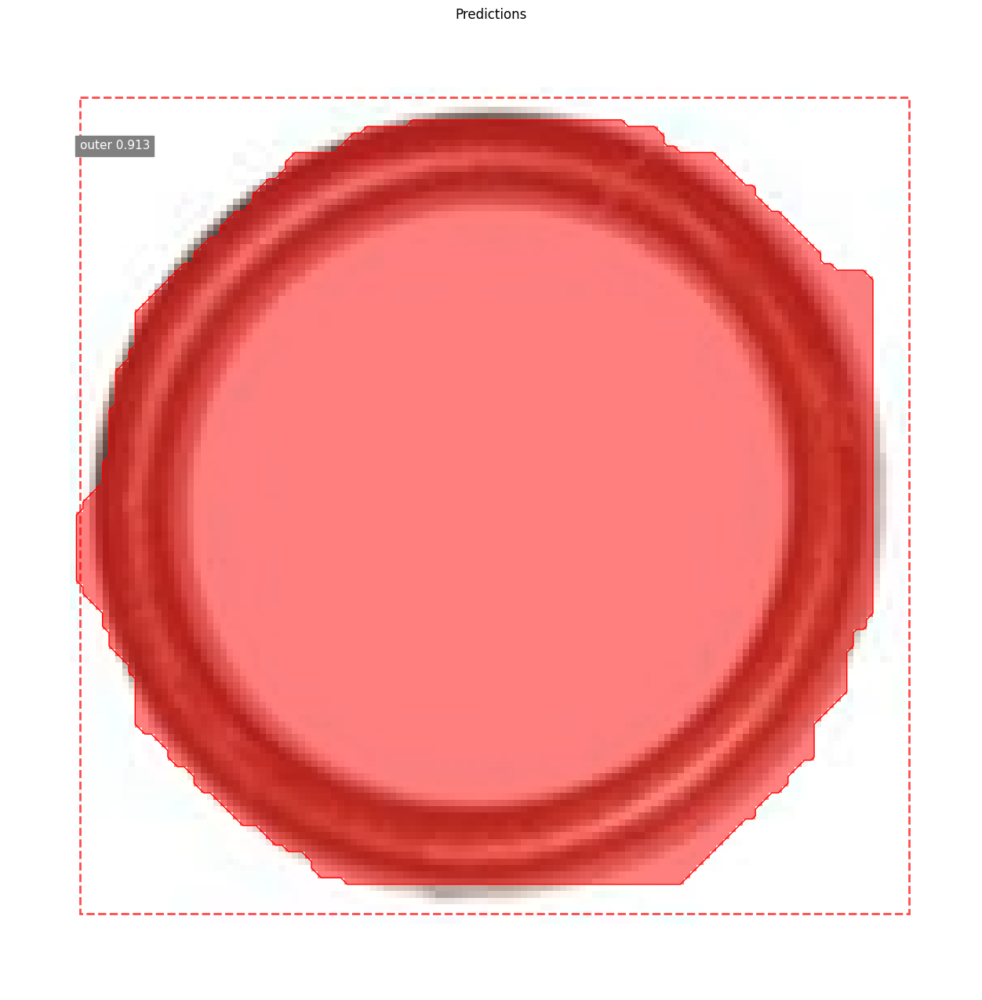


*** No instances to display *** 



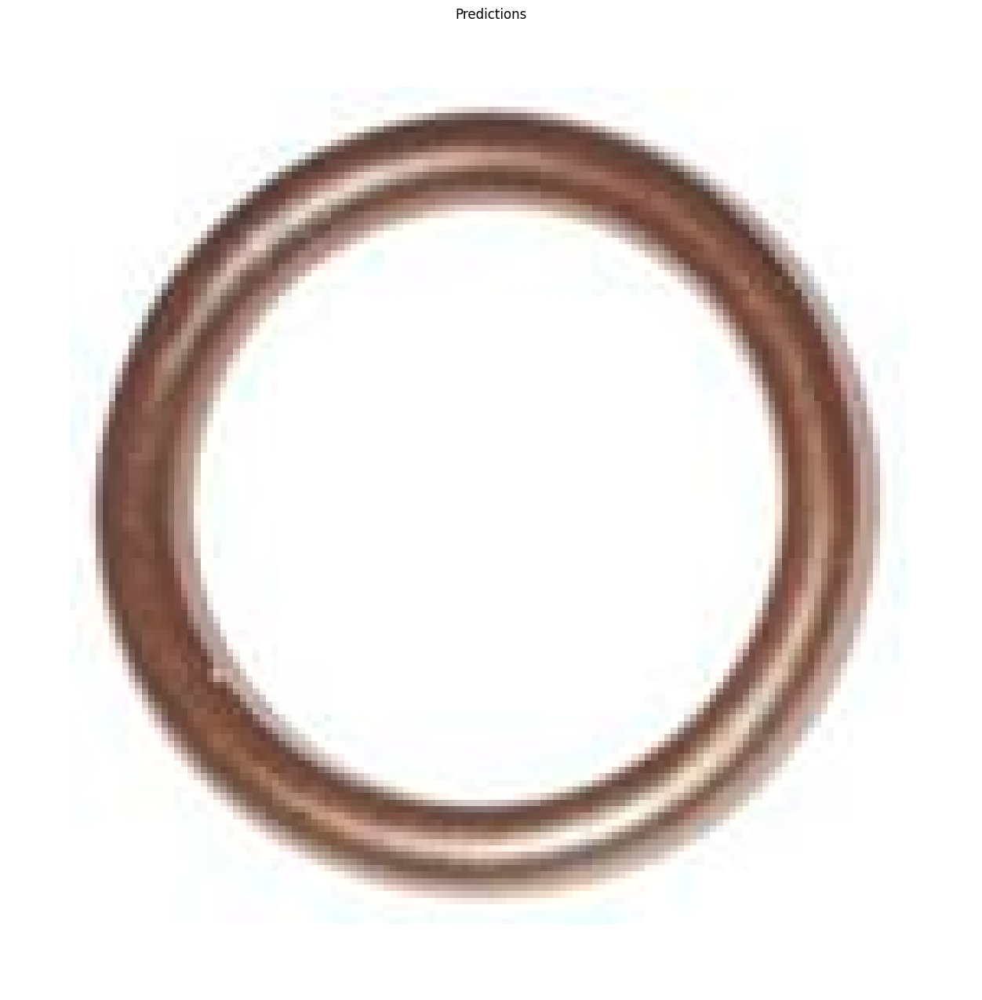


*** No instances to display *** 



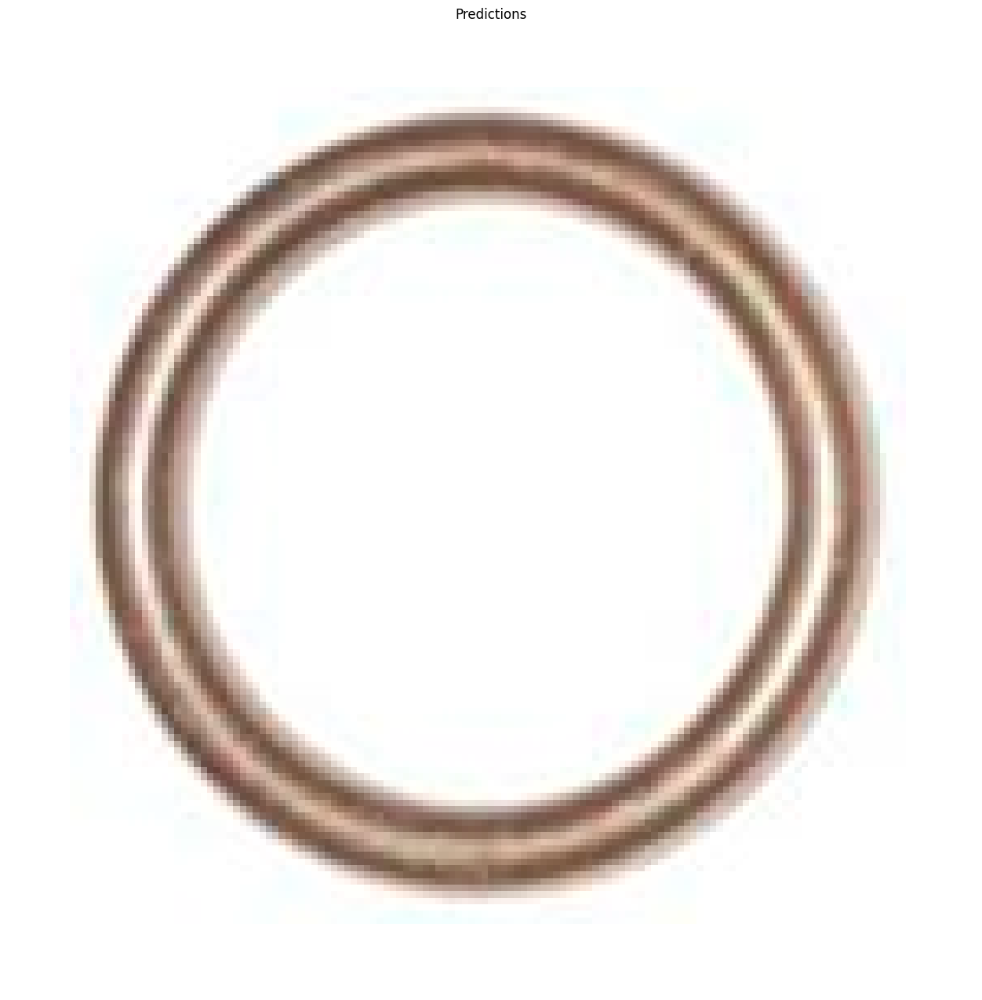

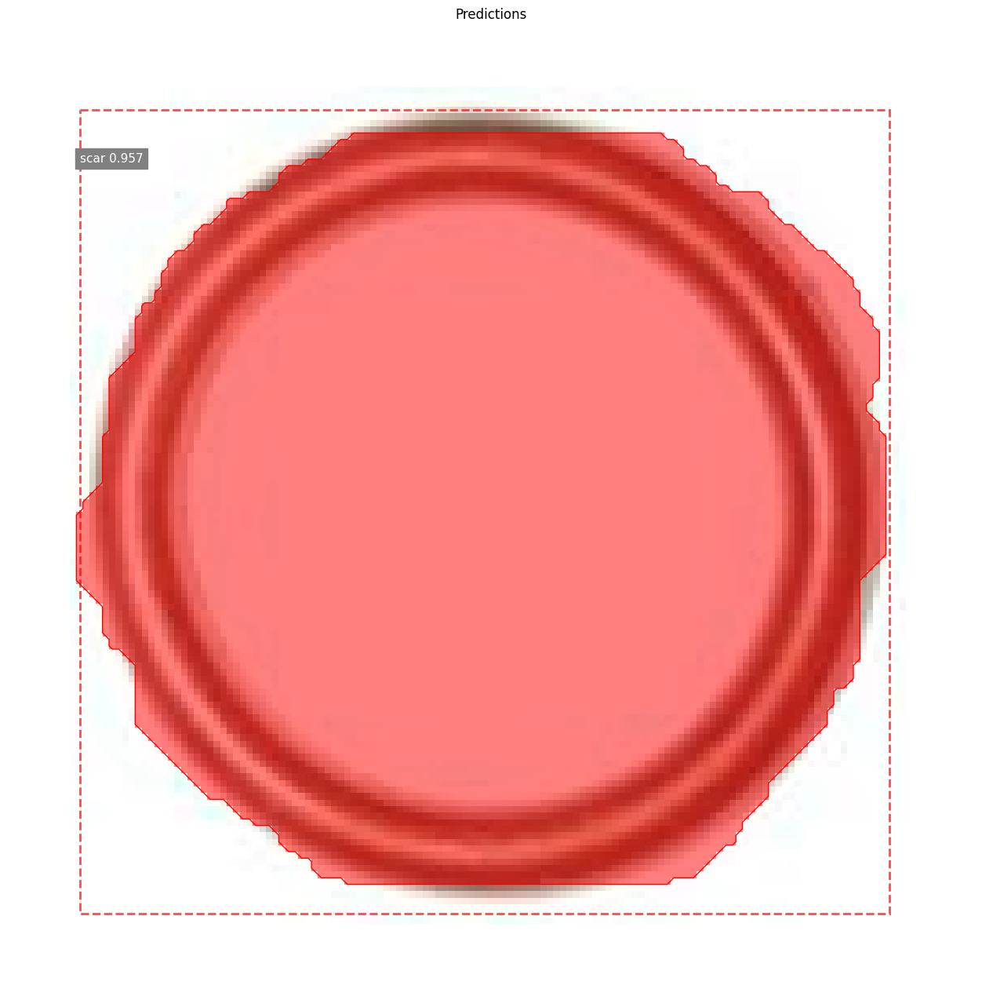


*** No instances to display *** 



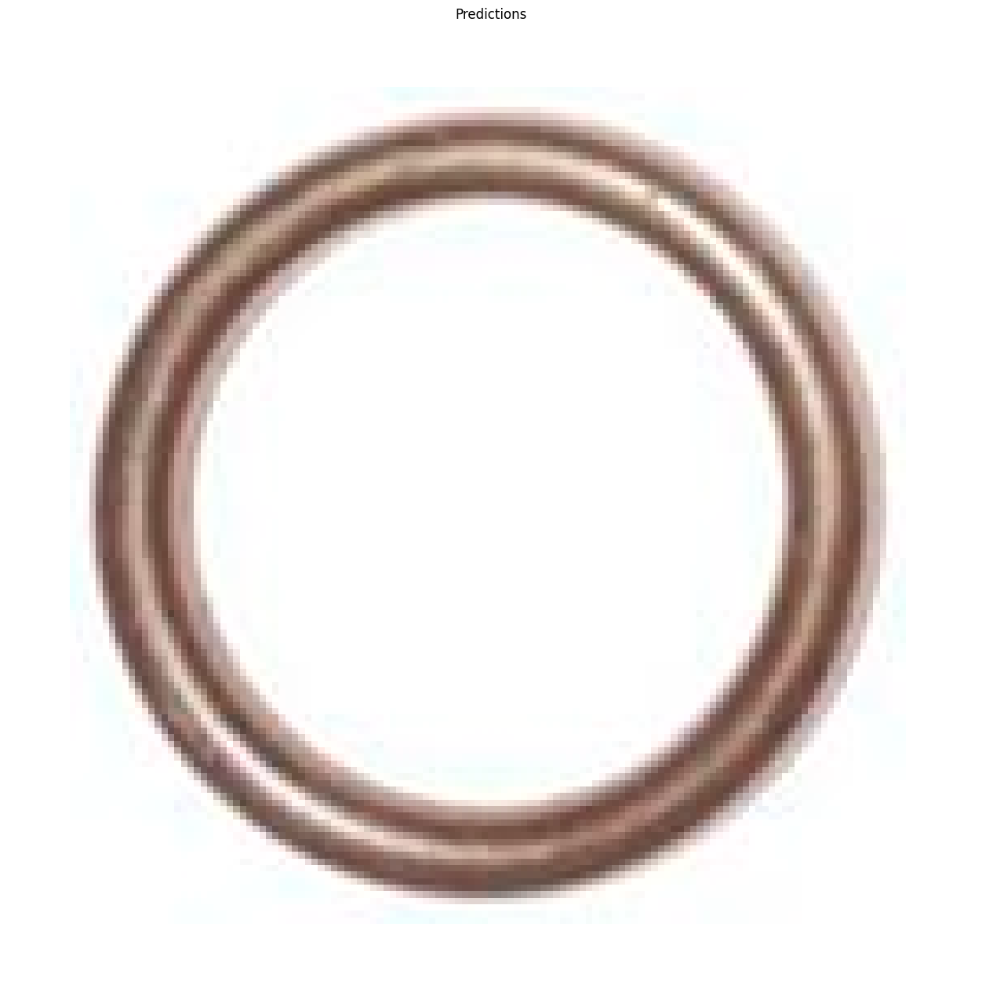

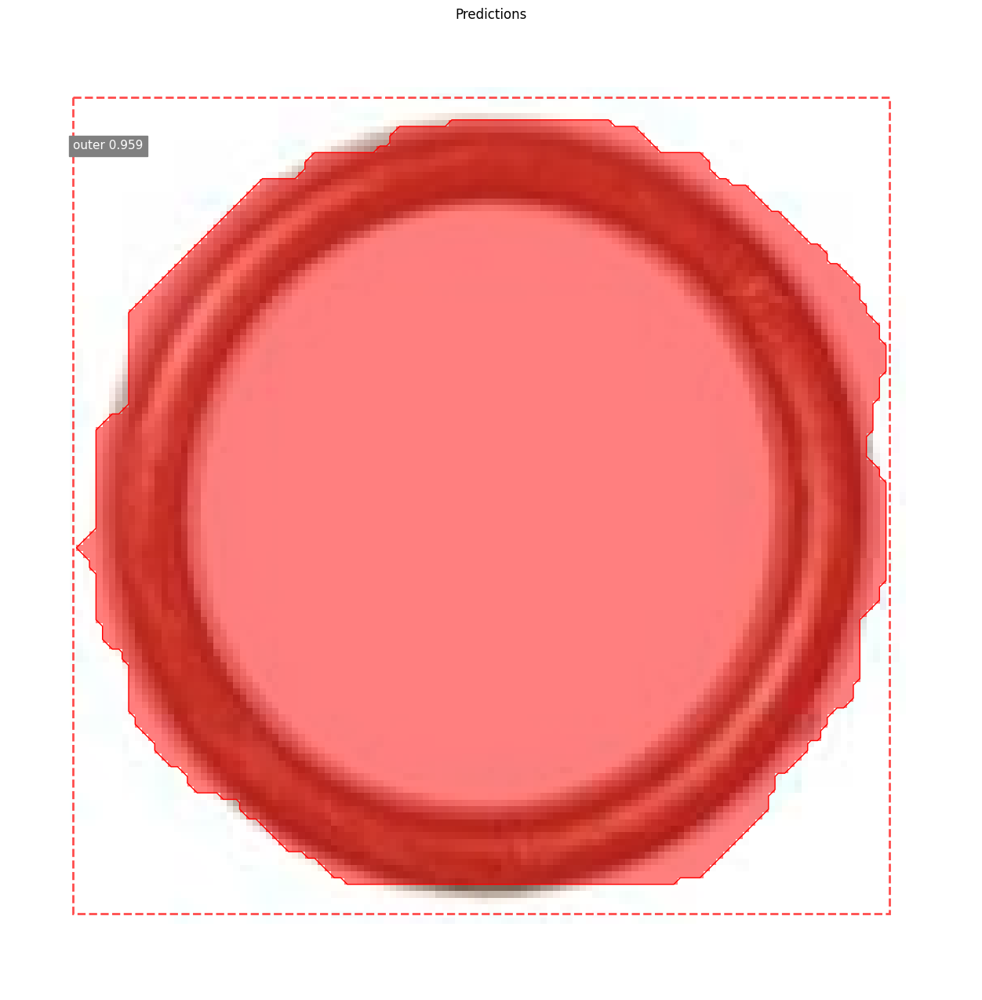


*** No instances to display *** 



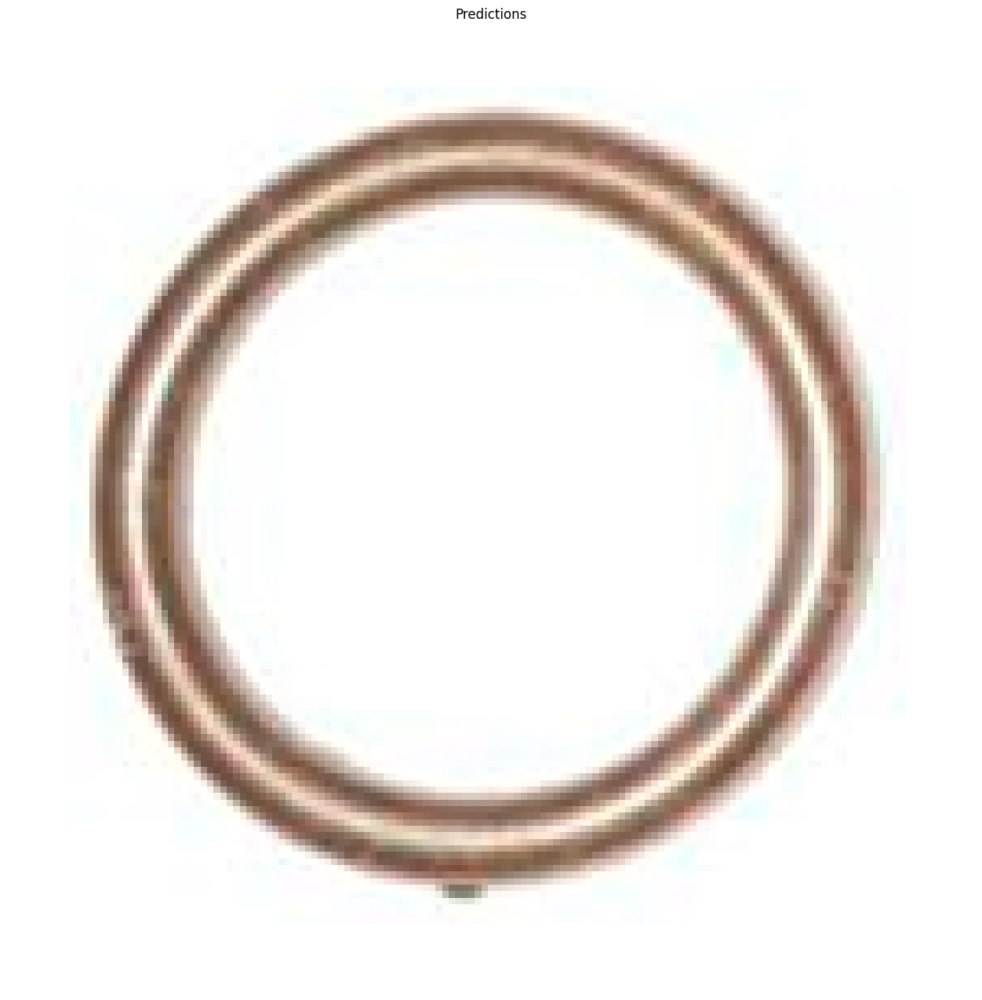

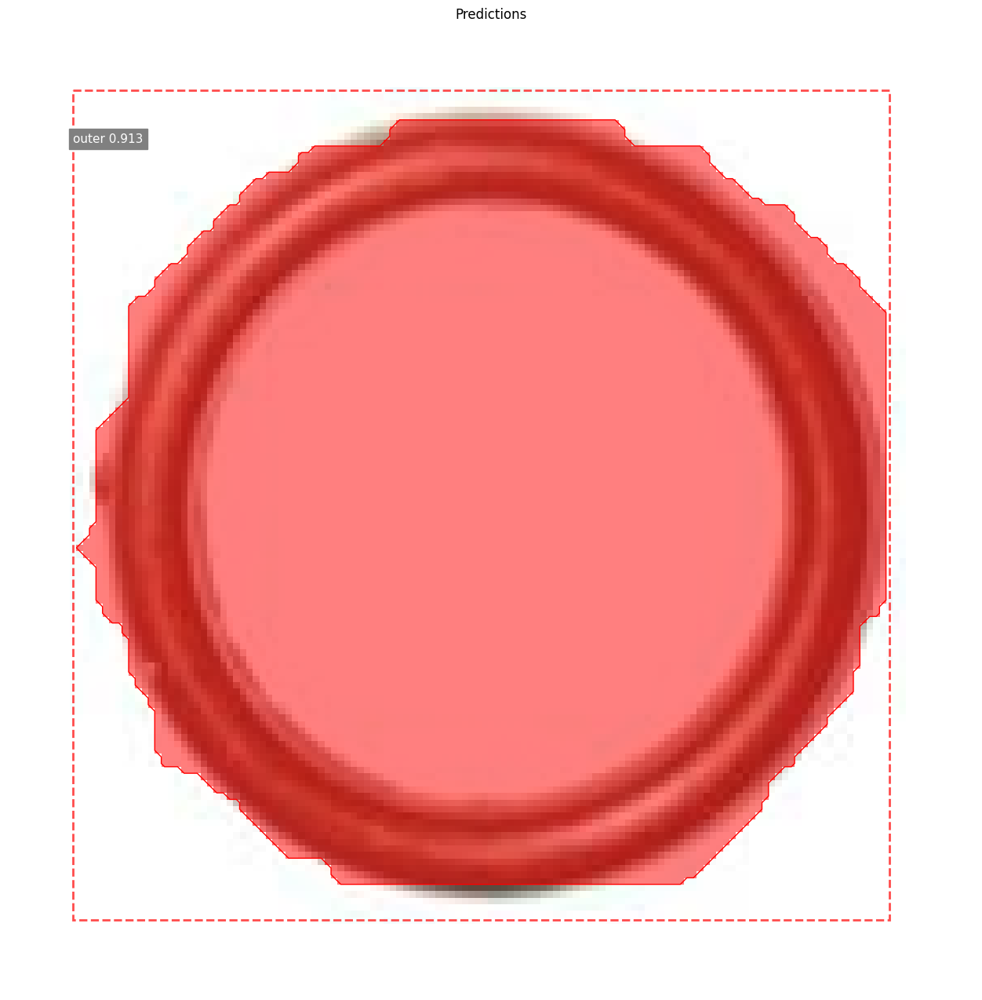

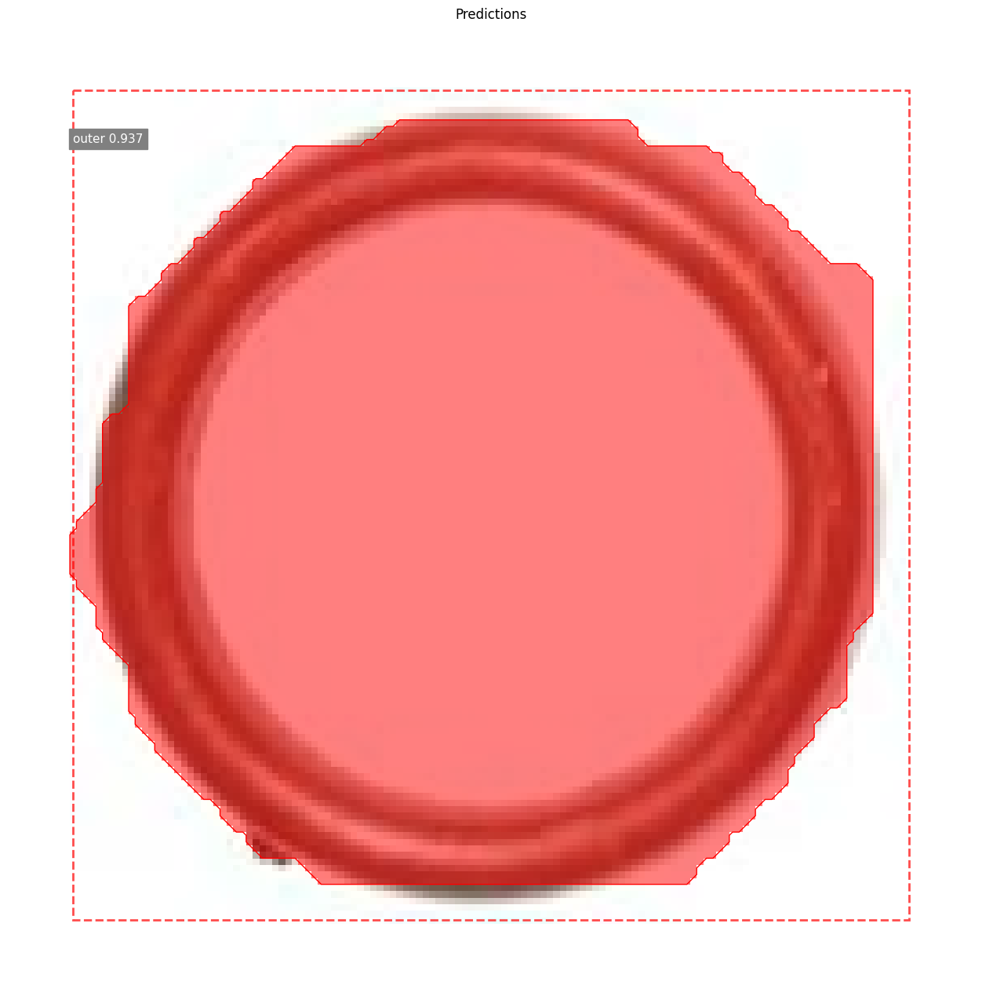

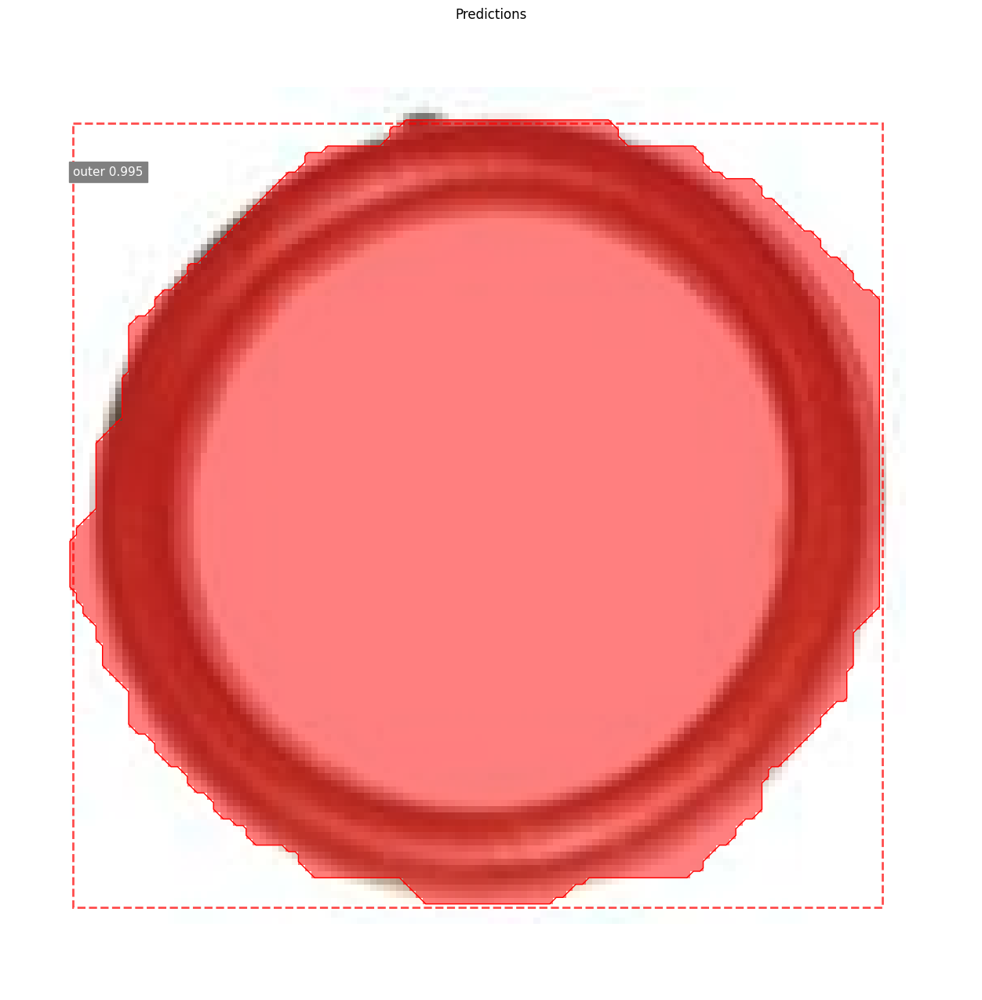


*** No instances to display *** 



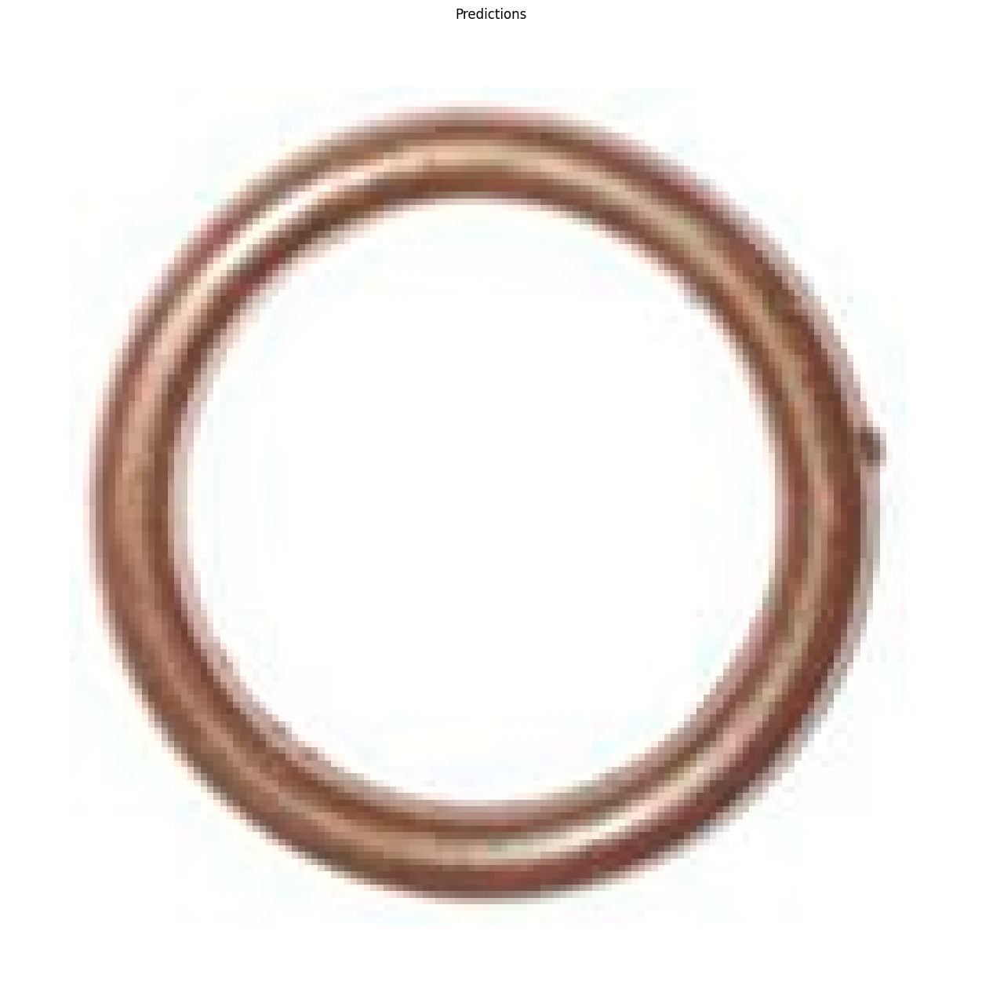

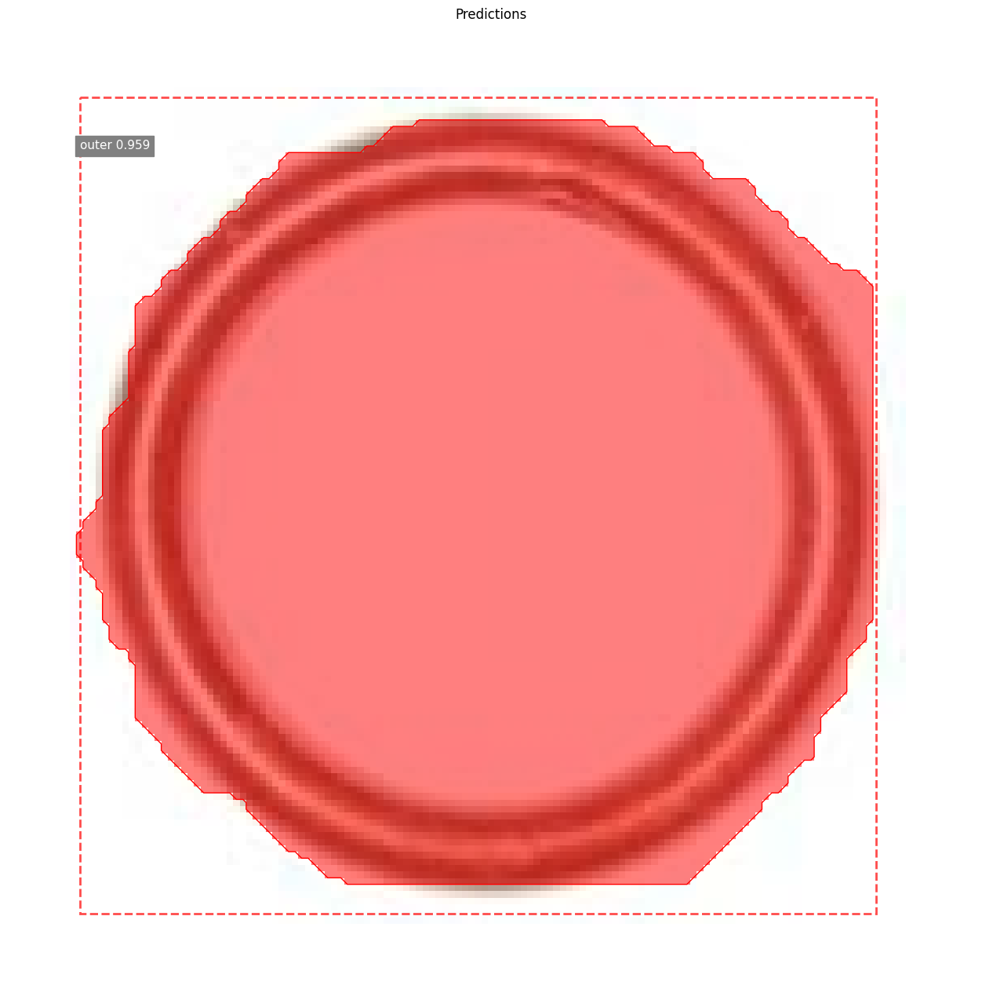


*** No instances to display *** 



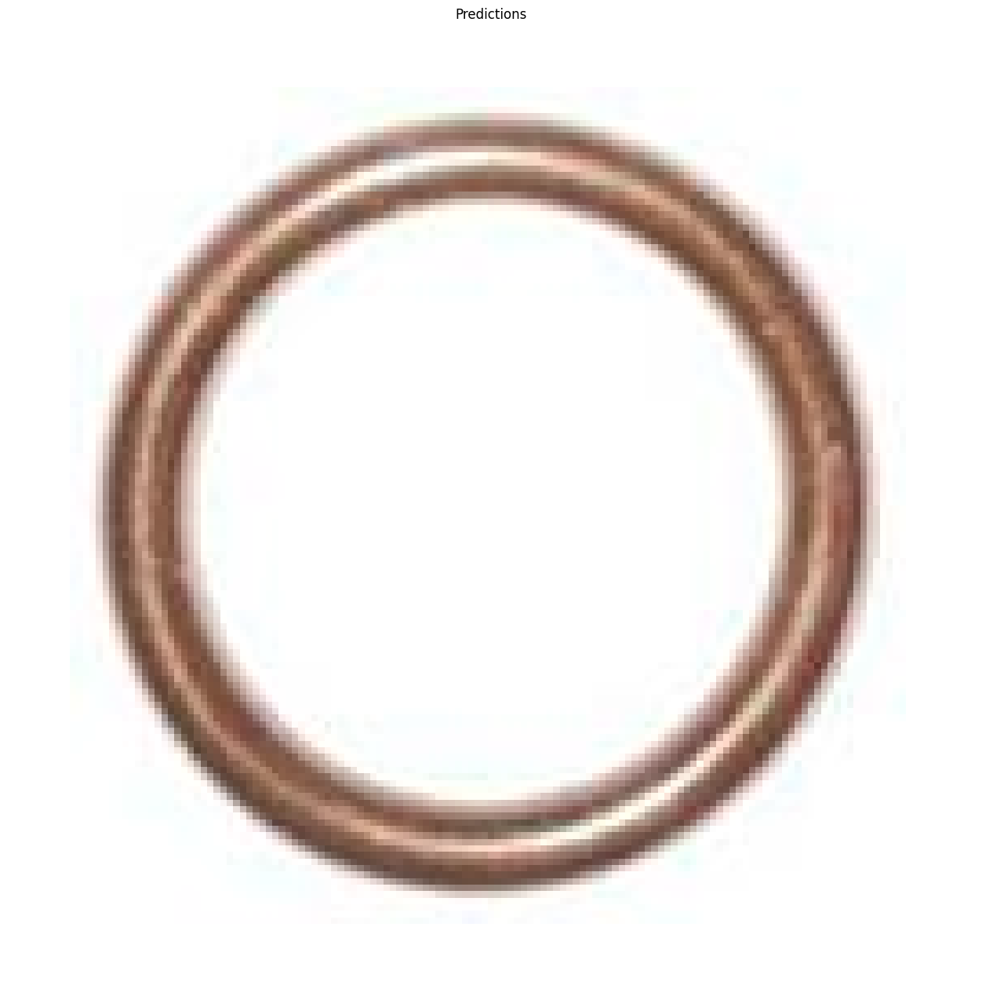

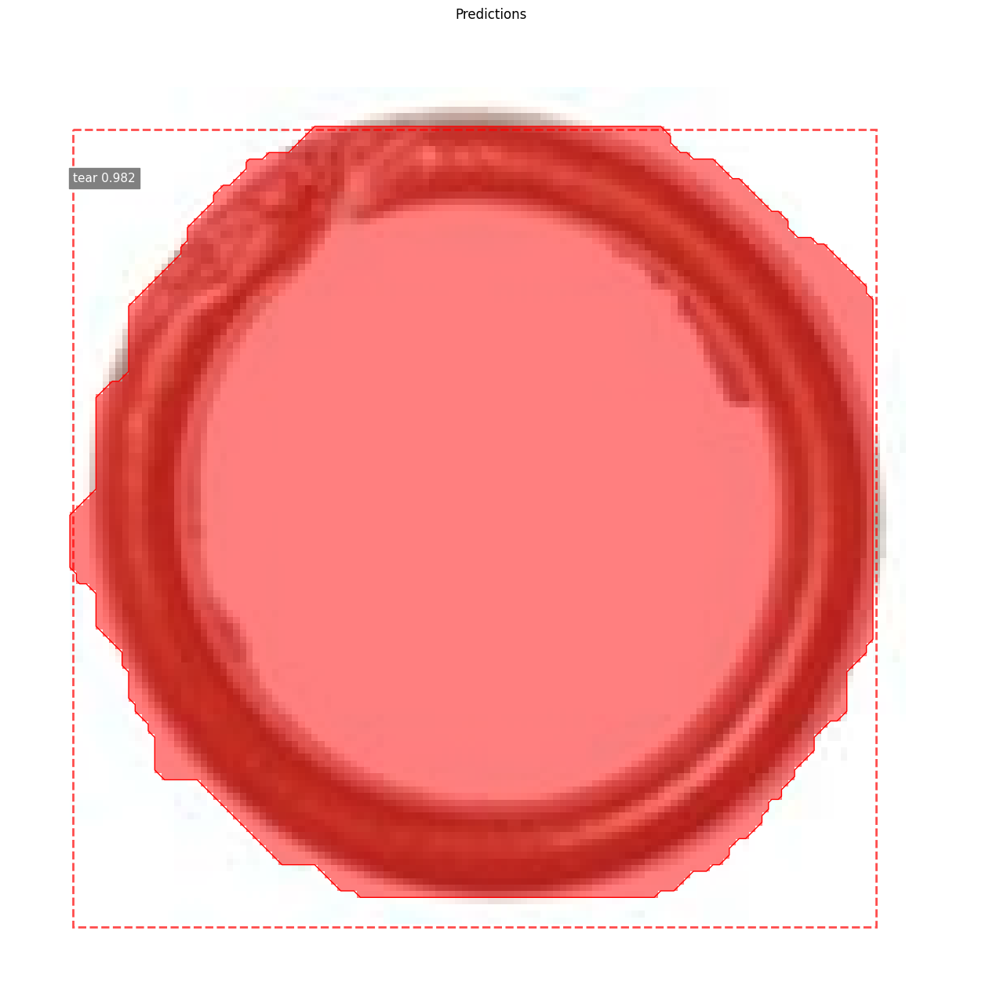

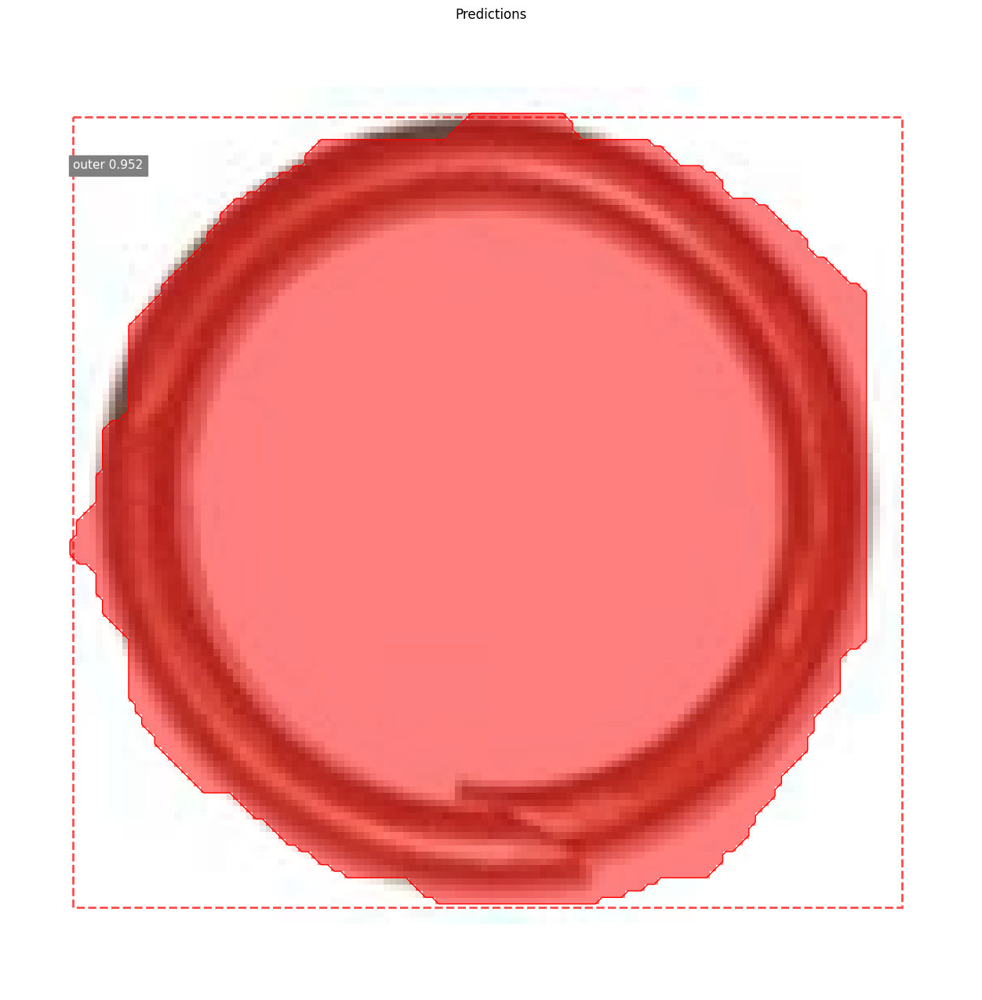

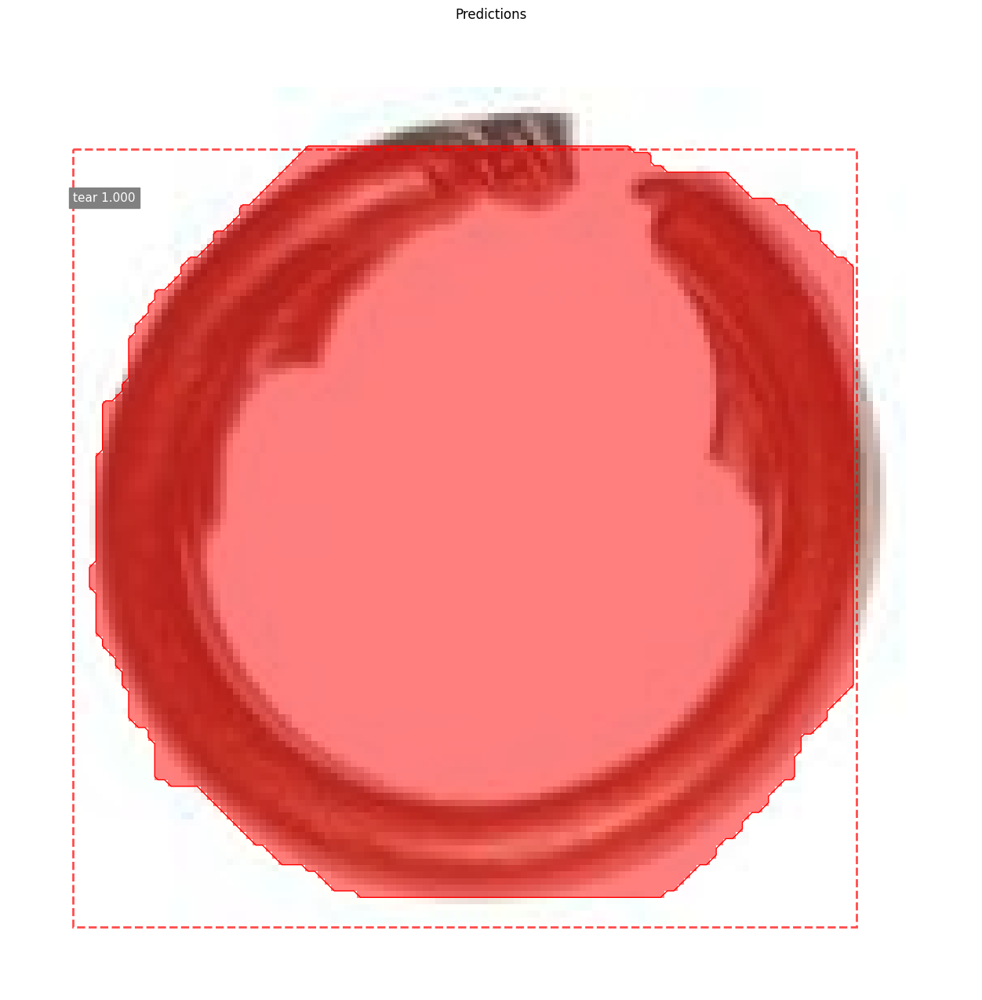

In [ ]:
for n in img_list:
    test_image = cv2.imread(n)
    results = model.detect([test_image])
    
    r = results[0]
    visualize.display_instances(test_image, r['rois'], r['masks'], r['class_ids'], 
                                dataset_val.class_names, r['scores'], 
                                title="Predictions")

In [ ]:
df_pred = pd.DataFrame()
for m in range(len(dataset_test.image_ids)):
        image_id = m
        image, image_meta, gt_class_id, gt_bbox, gt_mask=modellib.load_image_gt(dataset_test, infer_config, image_id, use_mini_mask=False)
        info = dataset_test.image_info[image_id]
    #     print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
    #                                            dataset_val.image_reference(image_id)))
        results = model.detect([image])
        r = results[0]
        try:
            dt = {
        'img_name' : [info["id"]],
        'predY' : [labels_to_names[r['class_ids'][0]]],
        'Y' : [info["id"][:info["id"].find('-')]]
        }
        except:
            dt = {
        'img_name' : [info["id"]],
        'predY' : ['Not Detected'],
        'Y' : [info["id"][:info["id"].find('-')]]
        }
        df_temp = pd.DataFrame(dt)

        df_pred = pd.concat([df_pred, df_temp])

In [ ]:
df_pred = df_pred.iloc[5:]

,index,img_name,predY,Y
5,0,block--32-_png.rf.58a0f9da9177658a172e4f722dae...,block,block
6,0,block--36-_png.rf.903bcf3fa6df140ce7ec5d9f66df...,block,block
7,0,block--38-_png.rf.6793d33f9c56c58e3d569b8250b8...,block,block
8,0,block--39-_png.rf.d5a0f9b0ec88065f75ad93e46fb3...,block,block
9,0,block--85-_png.rf.2f9fe7bd92c6bbf106acb1035478...,block,block
...,...,...,...,...
164,0,tear--47-_png.rf.cc2e36d5e07fb2e4b49d933192365...,tear,tear
165,0,tear--48-_png.rf.4ed6e856f1472479b4cb88b59d0d4...,tear,tear
166,0,tear--50-_png.rf.f0d948f152937f77222541e51e032...,tear,tear
167,0,tear--55-_png.rf.3ca299aa820fd13267d3e967cb5c2...,tear,tear


In [ ]:
type1_err = sum(df_pred[df_pred['Y'] == 'ok']['predY'] != 'ok')
type1_err

4

In [ ]:
sum(df_pred[df_pred['Y'] != 'ok']['predY'] == 'ok')

5

In [ ]:
type2_err = sum(df_pred[df_pred['Y'] != 'ok']['predY'] == 'ok') - 5
type2_err

0

In [ ]:
err_acc = (sum(df_pred[df_pred['Y'] != 'ok']['Y'] == df_pred[df_pred['Y'] != 'ok']['predY'])) / (sum(df_pred['Y'] != 'ok') - 5)

In [ ]:
model = modellib.MaskRCNN(mode="inference", model_dir='C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight', config=infer_config)

accuracy_rate = []

for n in weight_list:
    start_time = time()
    # callback에 의해 model weights 가 파일로 생성되며, 가장 마지막에 생성된 weights 가 가장 적은 loss를 가지는 것으로 가정. 
    weights_path = n
    print('model weight path:', weights_path)
    # 지정된 weight 파일명으로 모델에 로딩. 
    model.load_weights(weights_path, by_name=True)
    
    df_pred = pd.DataFrame()

    for m in range(len(dataset_test.image_ids)):
        image_id = m
        image, image_meta, gt_class_id, gt_bbox, gt_mask=modellib.load_image_gt(dataset_test, infer_config, image_id, use_mini_mask=False)
        info = dataset_test.image_info[image_id]
    #     print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
    #                                            dataset_val.image_reference(image_id)))
        results = model.detect([image])
        r = results[0]
        try:
            dt = {
        'img_name' : [info["id"]],
        'predY' : [labels_to_names[r['class_ids'][0]]],
        'Y' : [info["id"][:info["id"].find('-')]]
        }
        except:
            dt = {
        'img_name' : [info["id"]],
        'predY' : ['Not Detected'],
        'Y' : [info["id"][:info["id"].find('-')]]
        }
        df_temp = pd.DataFrame(dt)

        df_pred = pd.concat([df_pred, df_temp])

    df_pred = df_pred.iloc[5:]
    df_pred.reset_index(inplace=True)
    end_time = time()
    prec_time = end_time - start_time
    type1_err = sum(df_pred[df_pred['Y'] == 'ok']['predY'] != 'ok')
    type2_err = sum(df_pred[df_pred['Y'] != 'ok']['predY'] == 'ok')
    err_acc = (sum(df_pred[df_pred['Y'] != 'ok']['Y'] == df_pred[df_pred['Y'] != 'ok']['predY'])) / (sum(df_pred['Y'] != 'ok'))
    accuracy_rate.append([sum(df_pred['predY'] == df_pred['Y']) / (len(df_pred)), prec_time, type1_err, type2_err, err_acc])

accuracy_rate

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0001.h5
Re-starting from epoch 1
model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0002.h5
Re-starting from epoch 2
model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0003.h5
Re-starting from epoch 3
model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0004.h5
Re-starting from epoch 4
model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0005.h5
Re-starting from epoch 5
model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0006.h5
Re-starting from epoch 6
model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0007.h5
Re-starting from epoch 7
model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0008.h5
Re-starting from 

[[0.06097560975609756, 62.68637251853943, 69, 0, 0.0],
 [0.0, 49.84421467781067, 79, 0, 0.0],
 [0.13414634146341464, 50.99841237068176, 79, 0, 0.25882352941176473],
 [0.47560975609756095, 56.15231990814209, 11, 0, 0.11764705882352941],
 [0.4817073170731707, 50.35298037528992, 29, 0, 0.3411764705882353],
 [0.5792682926829268, 51.60472536087036, 21, 0, 0.43529411764705883],
 [0.6463414634146342, 51.31510543823242, 14, 0, 0.4823529411764706],
 [0.6158536585365854, 51.15938687324524, 21, 0, 0.5058823529411764],
 [0.774390243902439, 53.03486466407776, 3, 0, 0.6],
 [0.7378048780487805, 53.22792911529541, 4, 0, 0.5411764705882353],
 [0.8536585365853658, 52.87009358406067, 3, 0, 0.7529411764705882],
 [0.8597560975609756, 53.71823596954346, 3, 0, 0.7647058823529411],
 [0.8780487804878049, 53.23488187789917, 3, 0, 0.8],
 [0.9085365853658537, 53.48194074630737, 3, 0, 0.8588235294117647],
 [0.8902439024390244, 55.255794525146484, 4, 0, 0.8352941176470589],
 [0.9146341463414634, 55.88257694244385, 

In [ ]:
accuracy_rate

[[0.06097560975609756, 62.68637251853943, 69, 0, 0.0],
 [0.0, 49.84421467781067, 79, 0, 0.0],
 [0.13414634146341464, 50.99841237068176, 79, 0, 0.25882352941176473],
 [0.47560975609756095, 56.15231990814209, 11, 0, 0.11764705882352941],
 [0.4817073170731707, 50.35298037528992, 29, 0, 0.3411764705882353],
 [0.5792682926829268, 51.60472536087036, 21, 0, 0.43529411764705883],
 [0.6463414634146342, 51.31510543823242, 14, 0, 0.4823529411764706],
 [0.6158536585365854, 51.15938687324524, 21, 0, 0.5058823529411764],
 [0.774390243902439, 53.03486466407776, 3, 0, 0.6],
 [0.7378048780487805, 53.22792911529541, 4, 0, 0.5411764705882353],
 [0.8536585365853658, 52.87009358406067, 3, 0, 0.7529411764705882],
 [0.8597560975609756, 53.71823596954346, 3, 0, 0.7647058823529411],
 [0.8780487804878049, 53.23488187789917, 3, 0, 0.8],
 [0.9085365853658537, 53.48194074630737, 3, 0, 0.8588235294117647],
 [0.8902439024390244, 55.255794525146484, 4, 0, 0.8352941176470589],
 [0.9146341463414634, 55.88257694244385, 

In [ ]:
max(accuracy_rate)

[0.9634146341463414, 56.27317810058594, 3, 0, 0.9647058823529412]

In [ ]:
acc_lst = [[0.06097560975609756, 62.68637251853943, 69, 0, 0.0],
 [0.0, 49.84421467781067, 79, 0, 0.0],
 [0.13414634146341464, 50.99841237068176, 79, 0, 0.25882352941176473],
 [0.47560975609756095, 56.15231990814209, 11, 0, 0.11764705882352941],
 [0.4817073170731707, 50.35298037528992, 29, 0, 0.3411764705882353],
 [0.5792682926829268, 51.60472536087036, 21, 0, 0.43529411764705883],
 [0.6463414634146342, 51.31510543823242, 14, 0, 0.4823529411764706],
 [0.6158536585365854, 51.15938687324524, 21, 0, 0.5058823529411764],
 [0.774390243902439, 53.03486466407776, 3, 0, 0.6],
 [0.7378048780487805, 53.22792911529541, 4, 0, 0.5411764705882353],
 [0.8536585365853658, 52.87009358406067, 3, 0, 0.7529411764705882],
 [0.8597560975609756, 53.71823596954346, 3, 0, 0.7647058823529411],
 [0.8780487804878049, 53.23488187789917, 3, 0, 0.8],
 [0.9085365853658537, 53.48194074630737, 3, 0, 0.8588235294117647],
 [0.8902439024390244, 55.255794525146484, 4, 0, 0.8352941176470589],
 [0.9146341463414634, 55.88257694244385, 4, 0, 0.8823529411764706],
 [0.9512195121951219, 53.61865758895874, 4, 0, 0.9529411764705882],
 [0.9573170731707317, 53.61596870422363, 4, 0, 0.9647058823529412],
 [0.9634146341463414, 56.27317810058594, 3, 0, 0.9647058823529412],
 [0.8963414634146342, 53.79574966430664, 3, 1, 0.8352941176470589],
 [0.9573170731707317, 53.08200287818909, 3, 0, 0.9529411764705882],
 [0.9512195121951219, 54.22136187553406, 4, 0, 0.9529411764705882],
 [0.9573170731707317, 57.15680718421936, 3, 0, 0.9529411764705882],
 [0.9512195121951219, 57.10945129394531, 4, 0, 0.9529411764705882],
 [0.9573170731707317, 55.3478639125824, 3, 1, 0.9529411764705882],
 [0.9573170731707317, 55.500059843063354, 3, 1, 0.9529411764705882],
 [0.9512195121951219, 54.615904569625854, 3, 1, 0.9411764705882353],
 [0.9573170731707317, 58.716961145401, 3, 1, 0.9529411764705882],
 [0.9512195121951219, 55.85465621948242, 4, 1, 0.9529411764705882],
 [0.9573170731707317, 53.700647830963135, 4, 0, 0.9647058823529412]]

In [ ]:
# dataset중에 임의의 파일을 한개 선택. 
#image_id = np.random.choice(dataset.image_ids)
image_id = 5
image, image_meta, gt_class_id, gt_bbox, gt_mask=modellib.load_image_gt(dataset_val, infer_config, image_id, use_mini_mask=False)
info = dataset_val.image_info[image_id]
print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
                                       dataset_val.image_reference(image_id)))

# Run object detection
results = model.detect([image], verbose=1)

image ID: oring.block--28-_png.rf.3e07901765fcbdace5861f356ec82e50.jpg (5) 


model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0001.h5
Re-starting from epoch 1
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32

*** No instances to display *** 



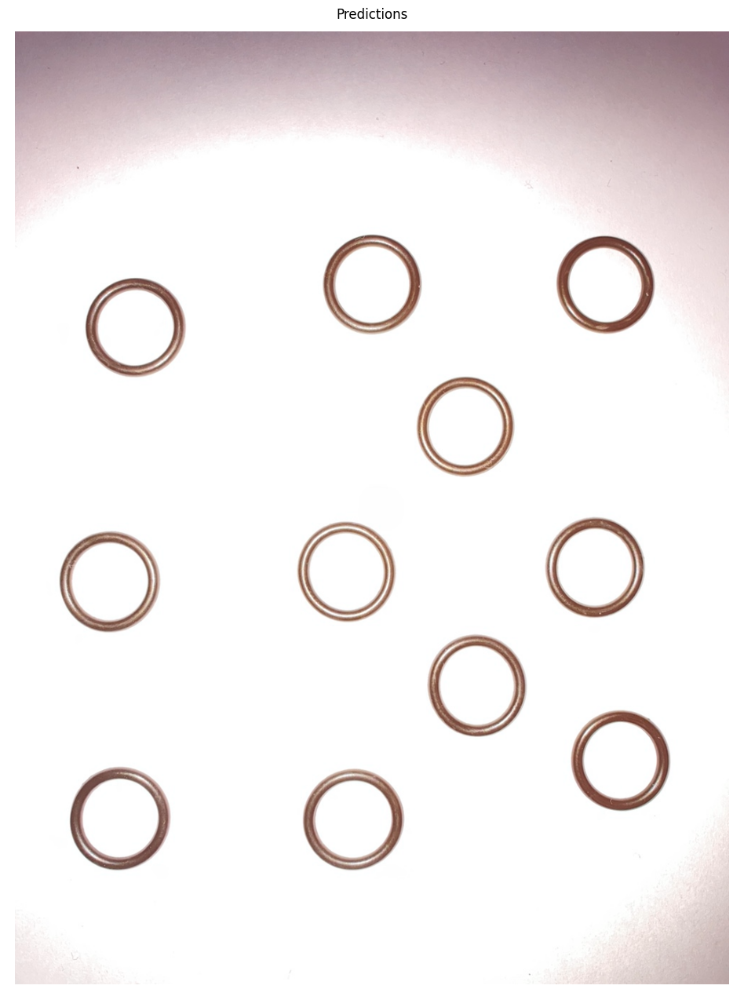

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0002.h5
Re-starting from epoch 2
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32

*** No instances to display *** 



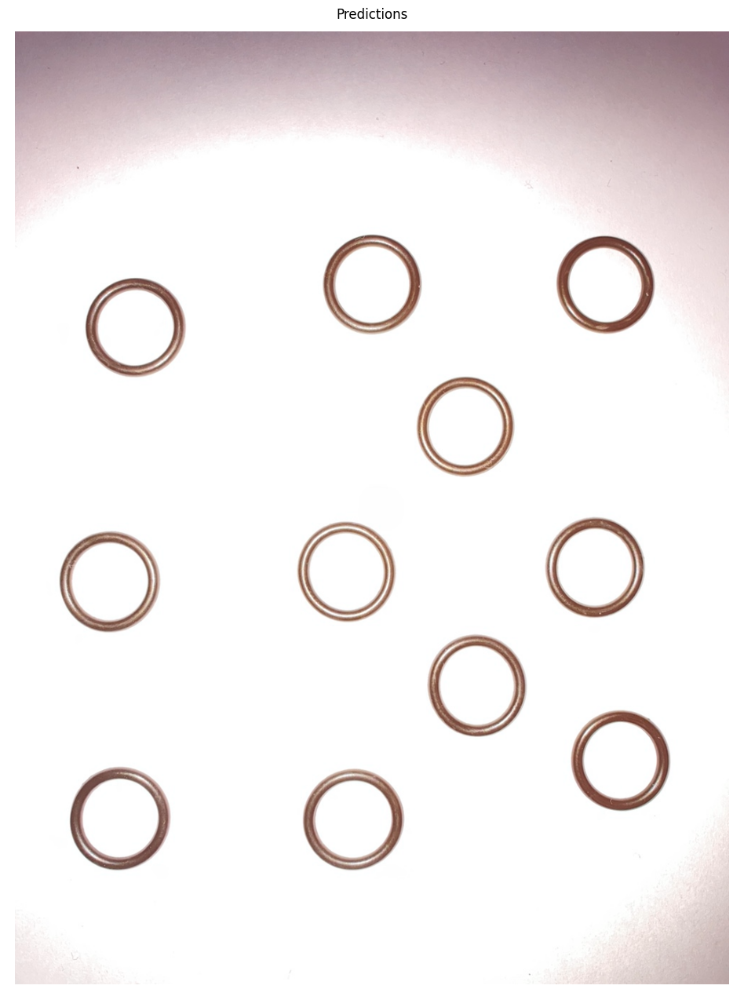

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0003.h5
Re-starting from epoch 3
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


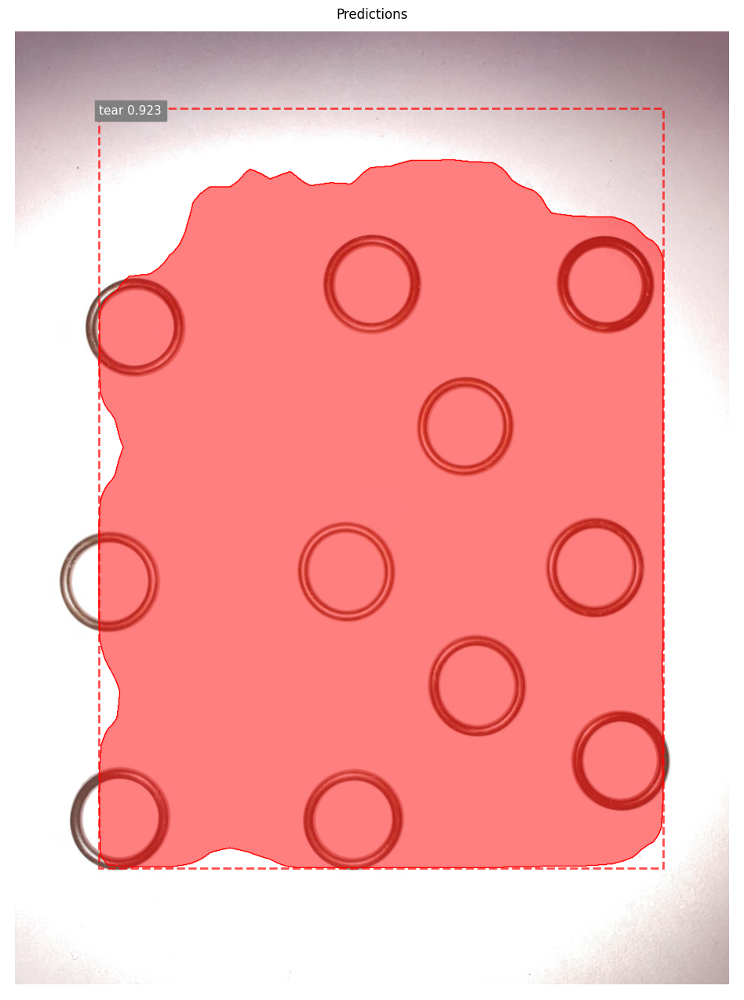

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0004.h5
Re-starting from epoch 4
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


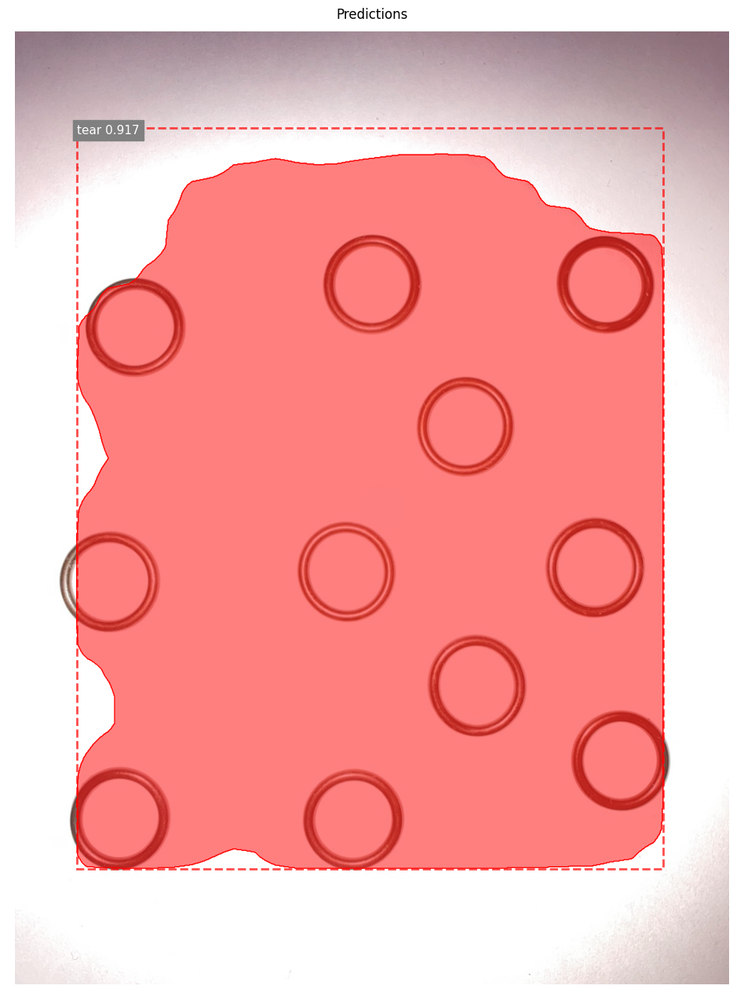

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0005.h5
Re-starting from epoch 5
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


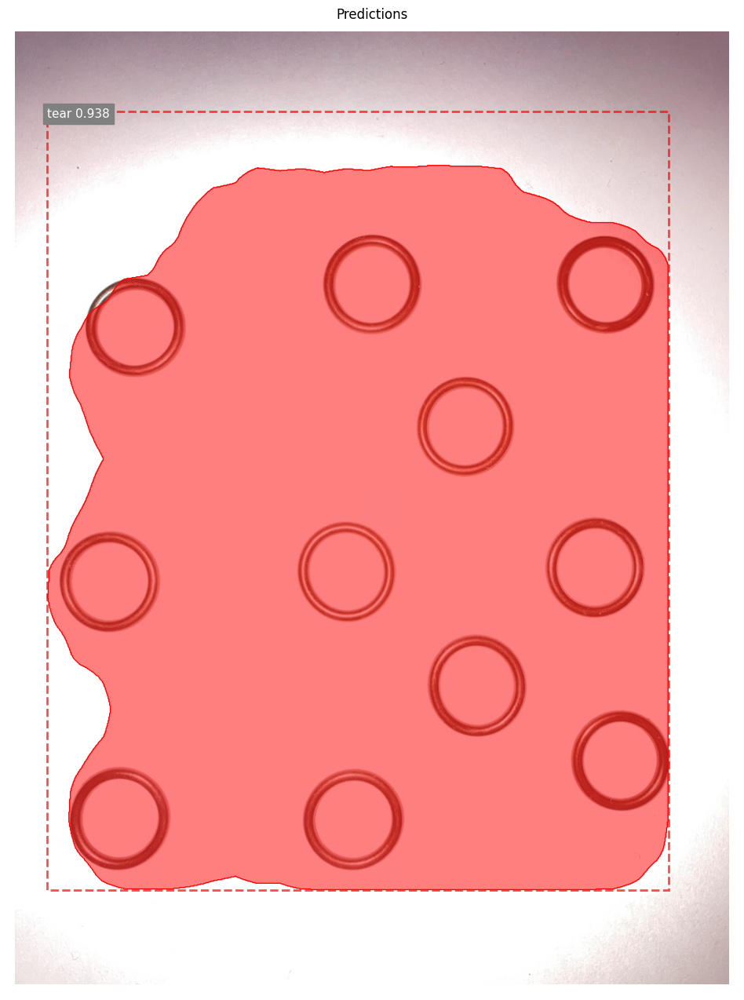

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0006.h5
Re-starting from epoch 6
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


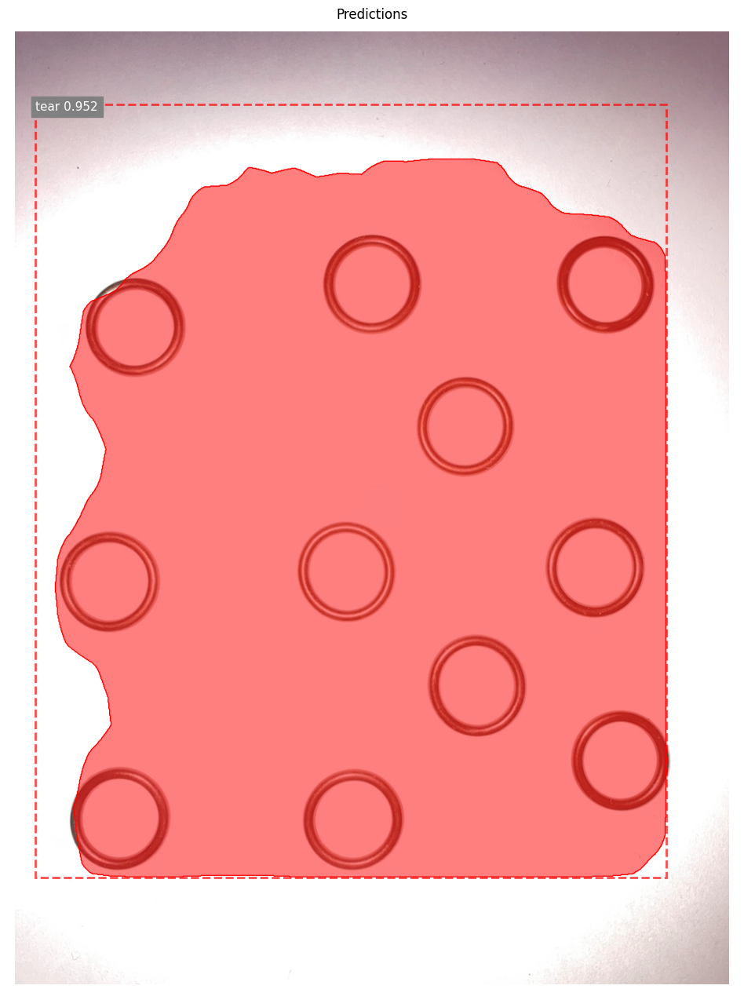

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0007.h5
Re-starting from epoch 7
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


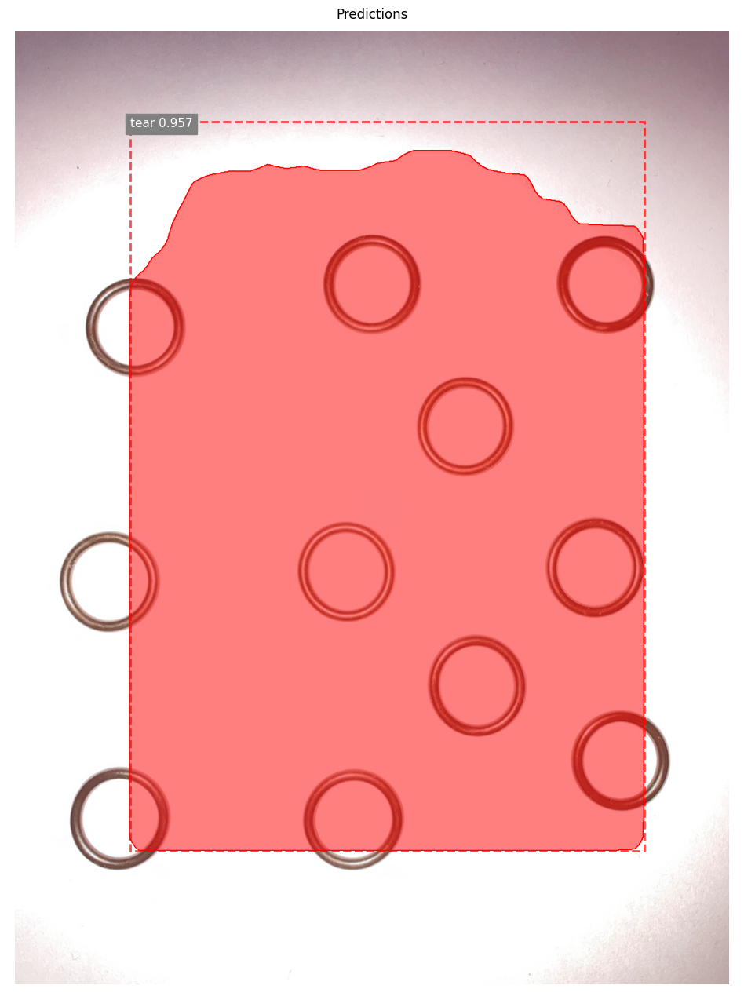

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0008.h5
Re-starting from epoch 8
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


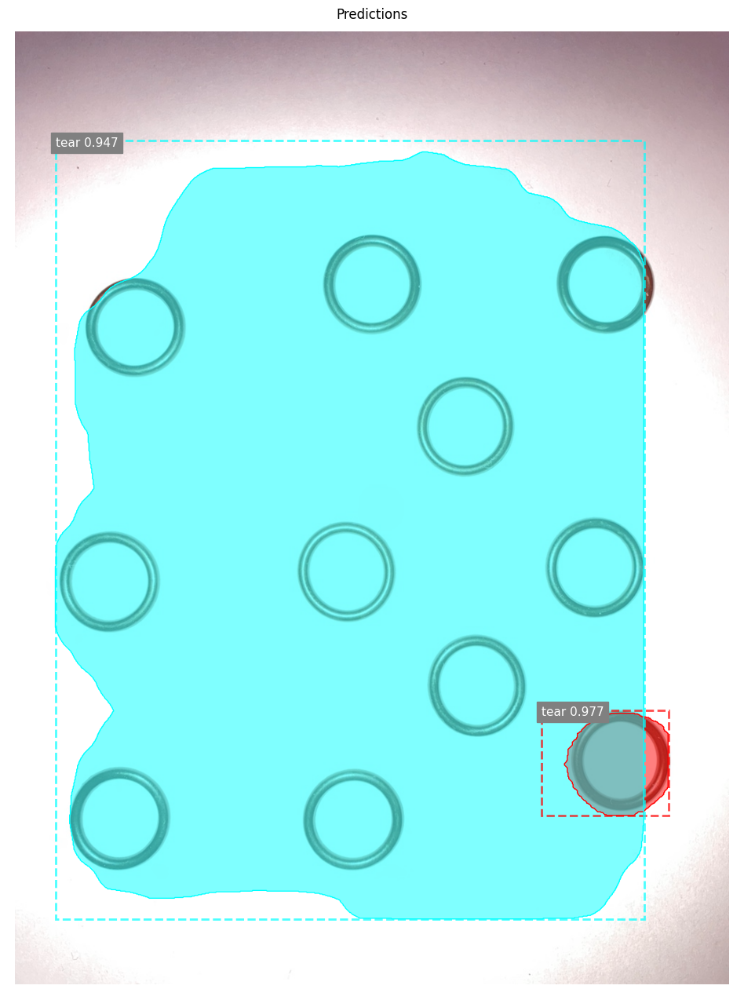

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0009.h5
Re-starting from epoch 9
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


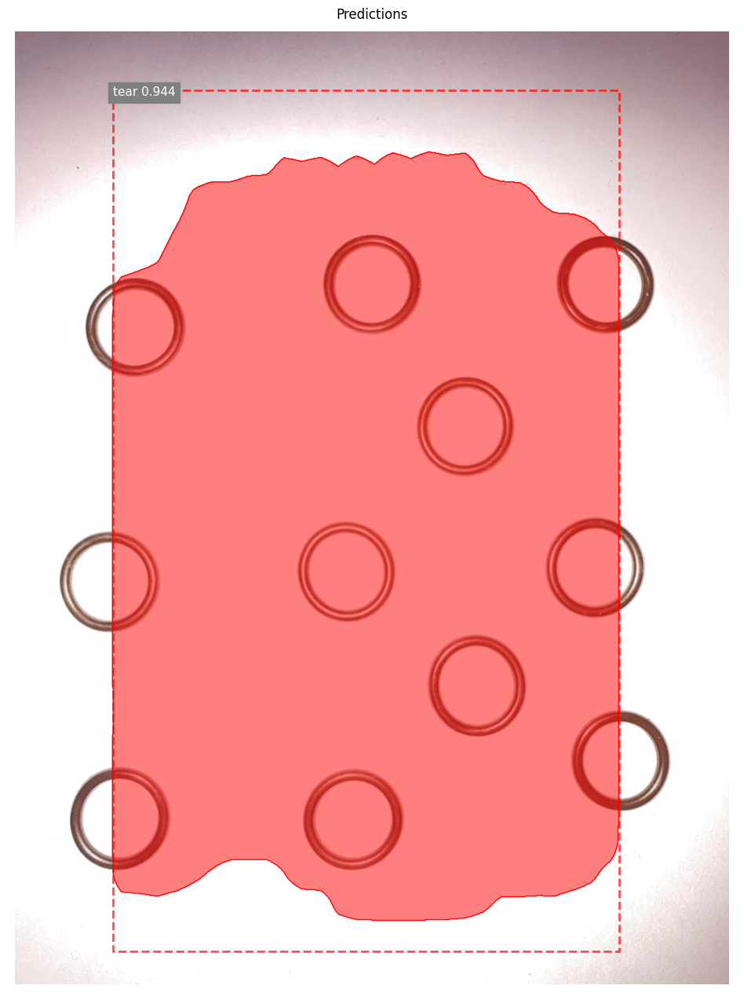

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0010.h5
Re-starting from epoch 10
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


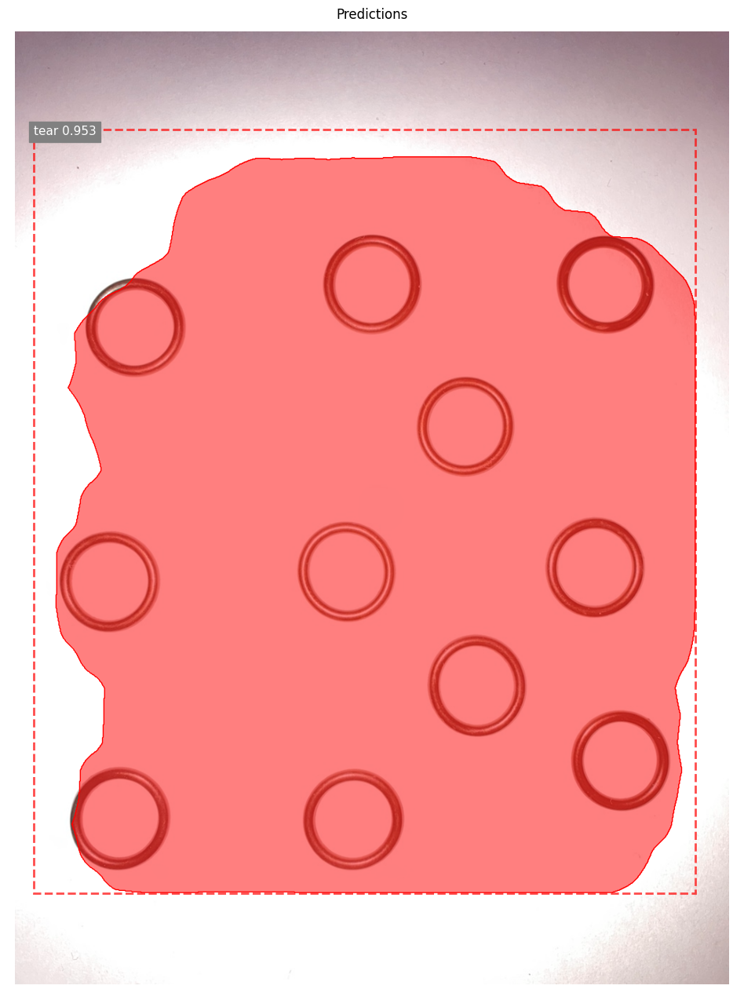

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0011.h5
Re-starting from epoch 11
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


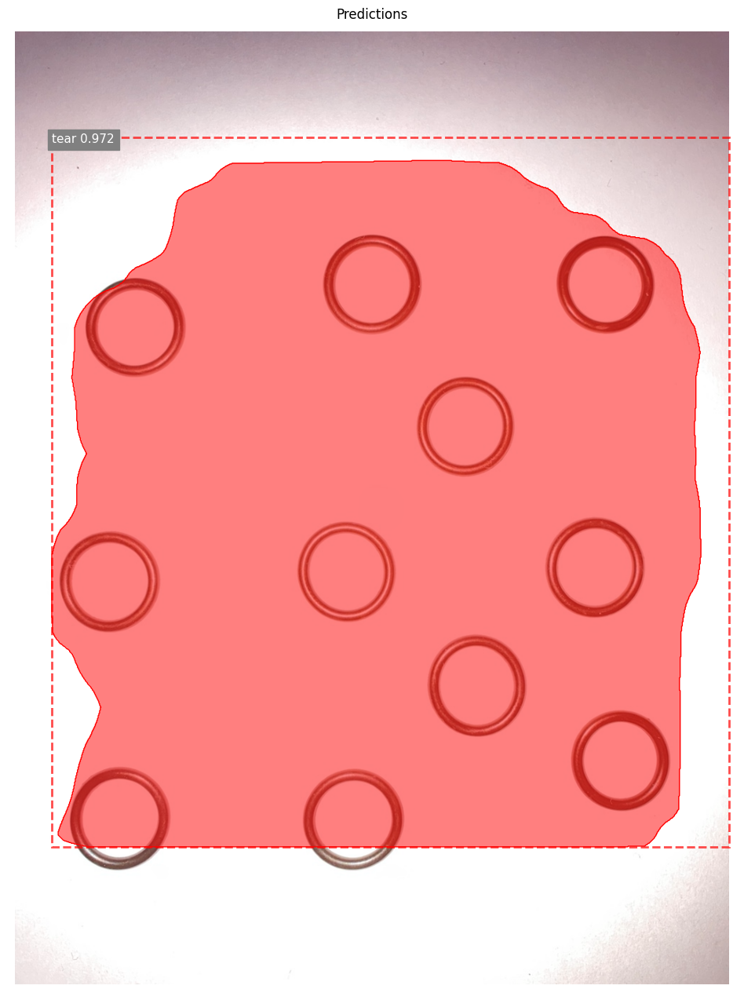

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0012.h5
Re-starting from epoch 12
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


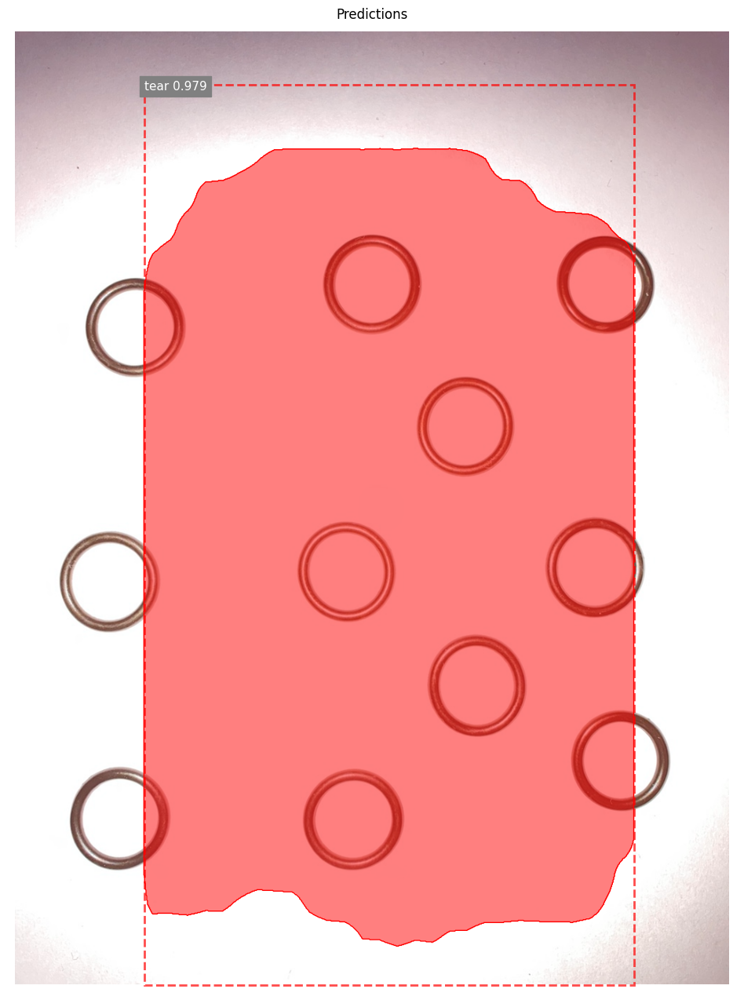

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0013.h5
Re-starting from epoch 13
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


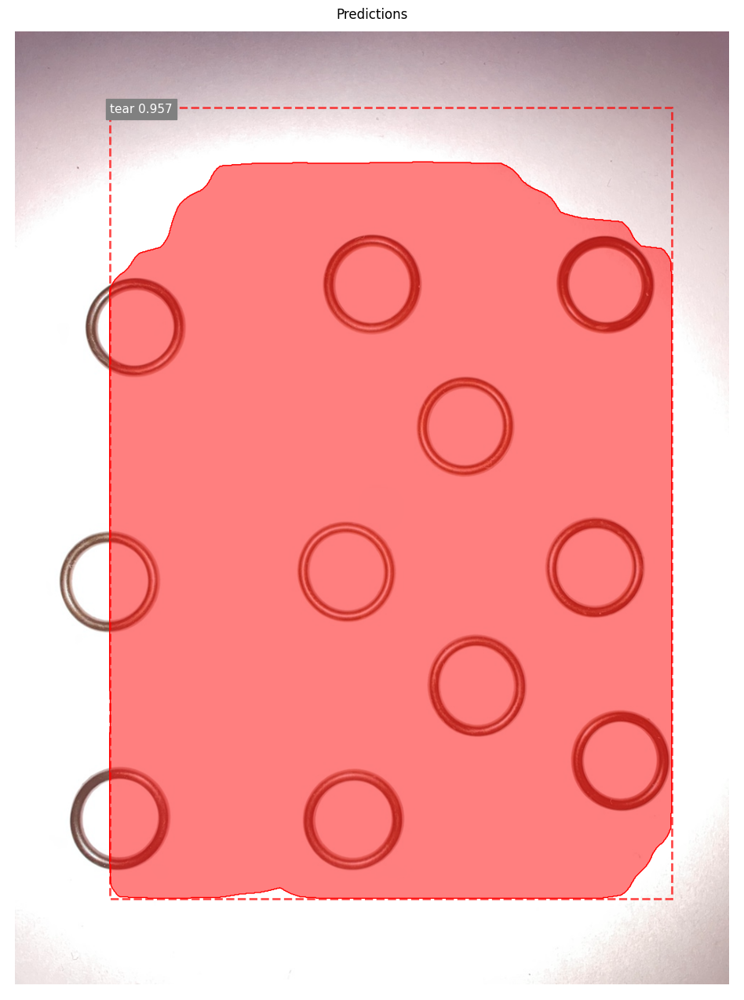

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0014.h5
Re-starting from epoch 14
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


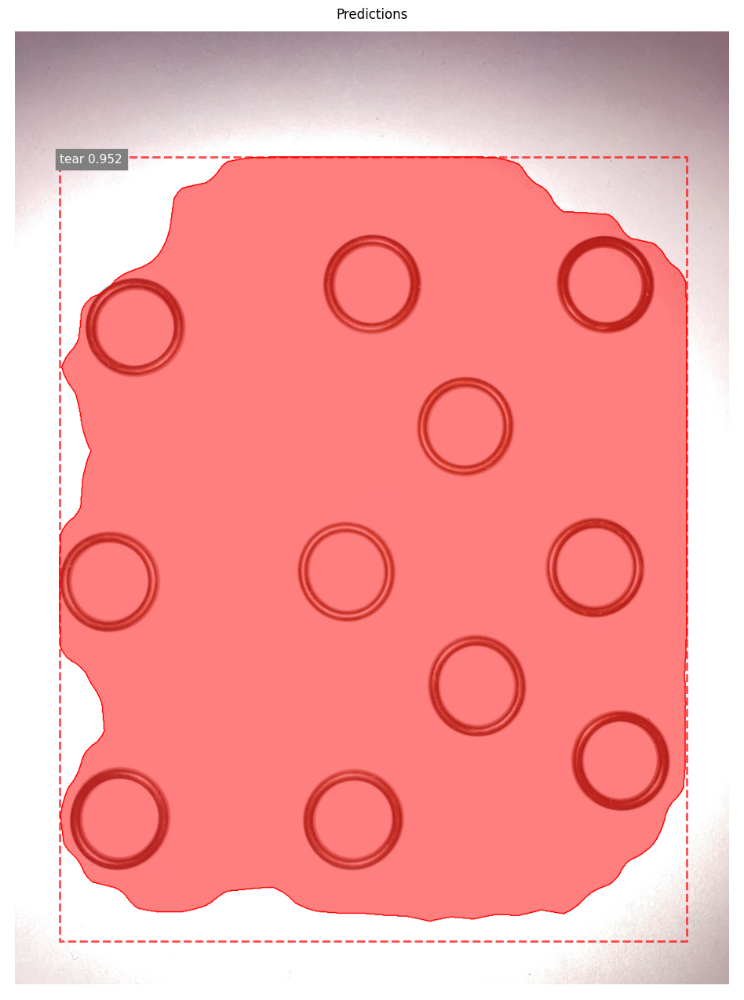

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0015.h5
Re-starting from epoch 15
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


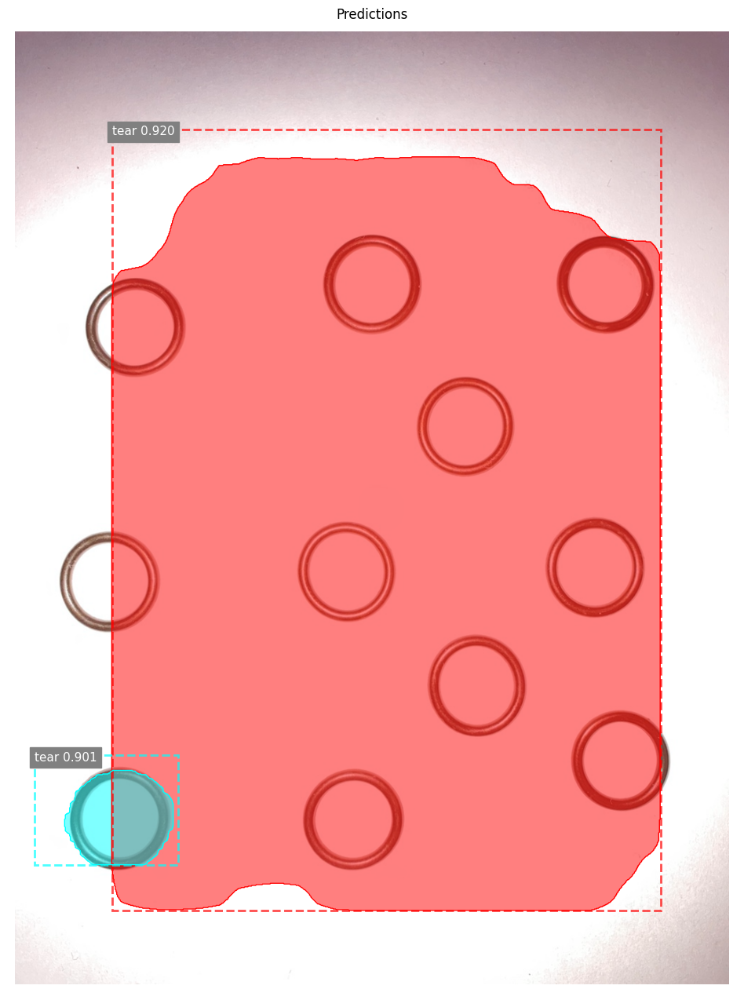

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0016.h5
Re-starting from epoch 16
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


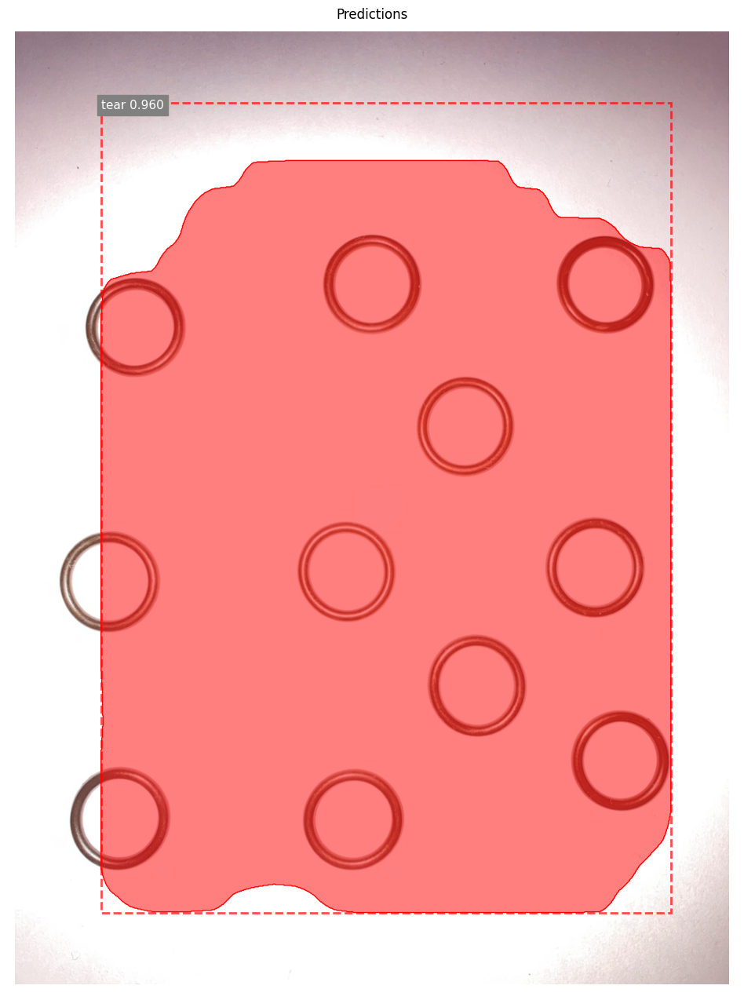

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0017.h5
Re-starting from epoch 17
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


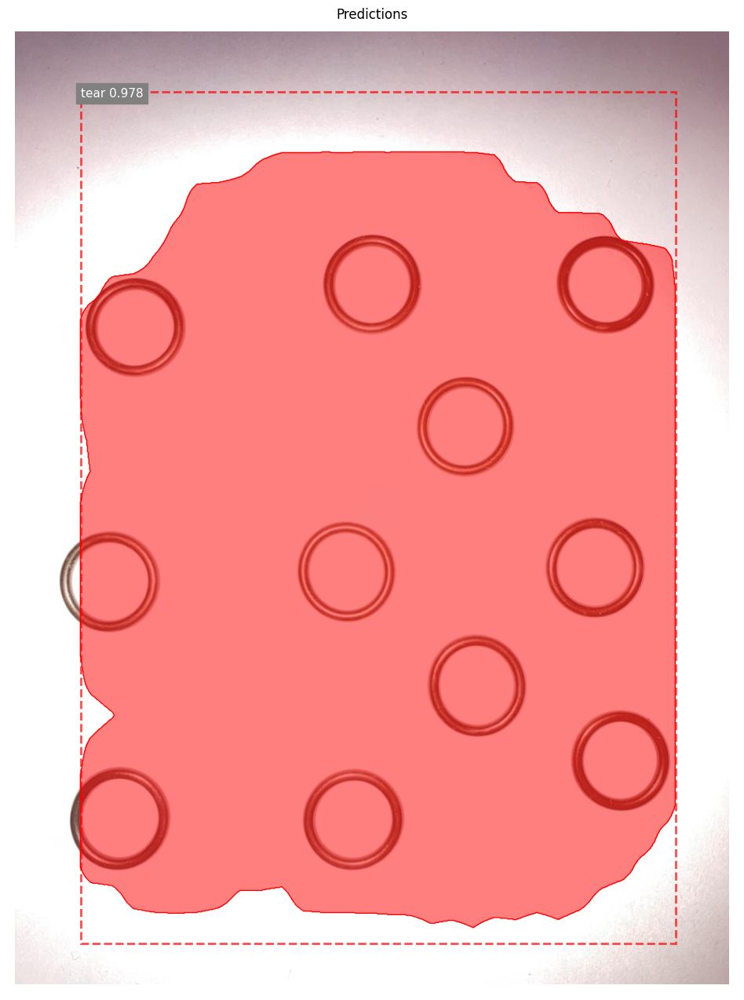

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0018.h5
Re-starting from epoch 18
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


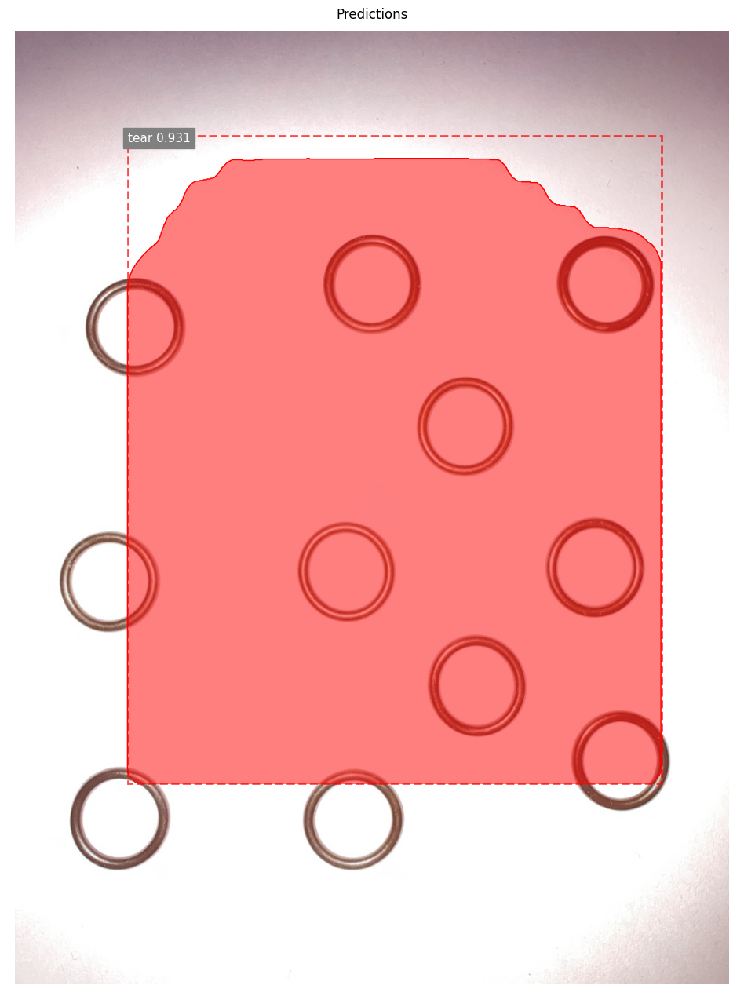

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0019.h5
Re-starting from epoch 19
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


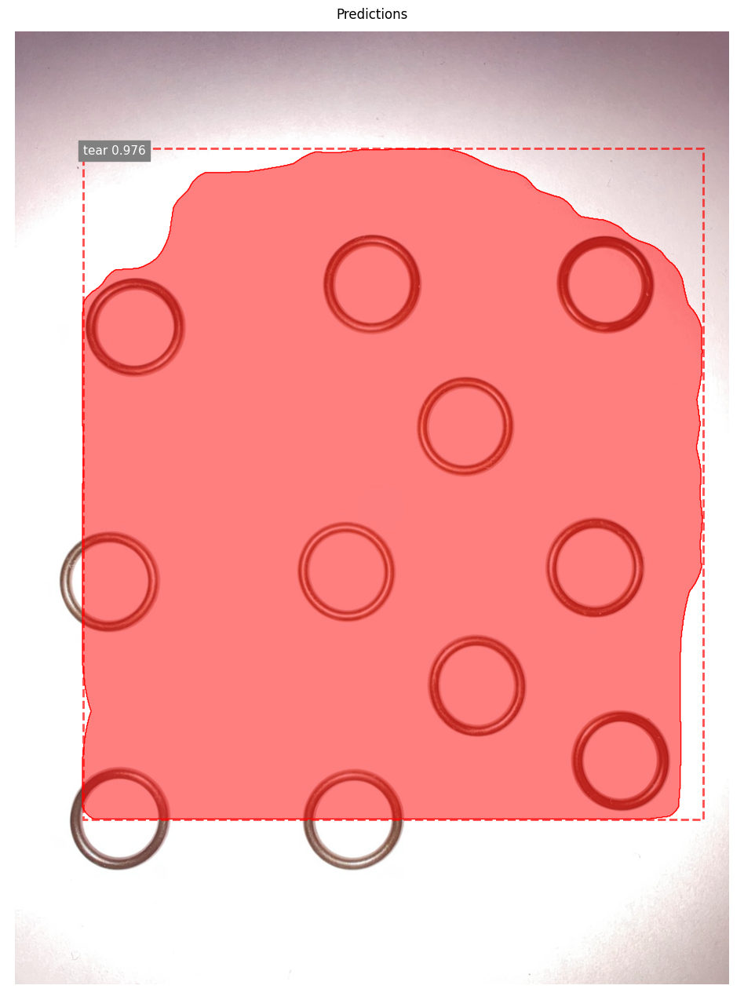

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0020.h5
Re-starting from epoch 20
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


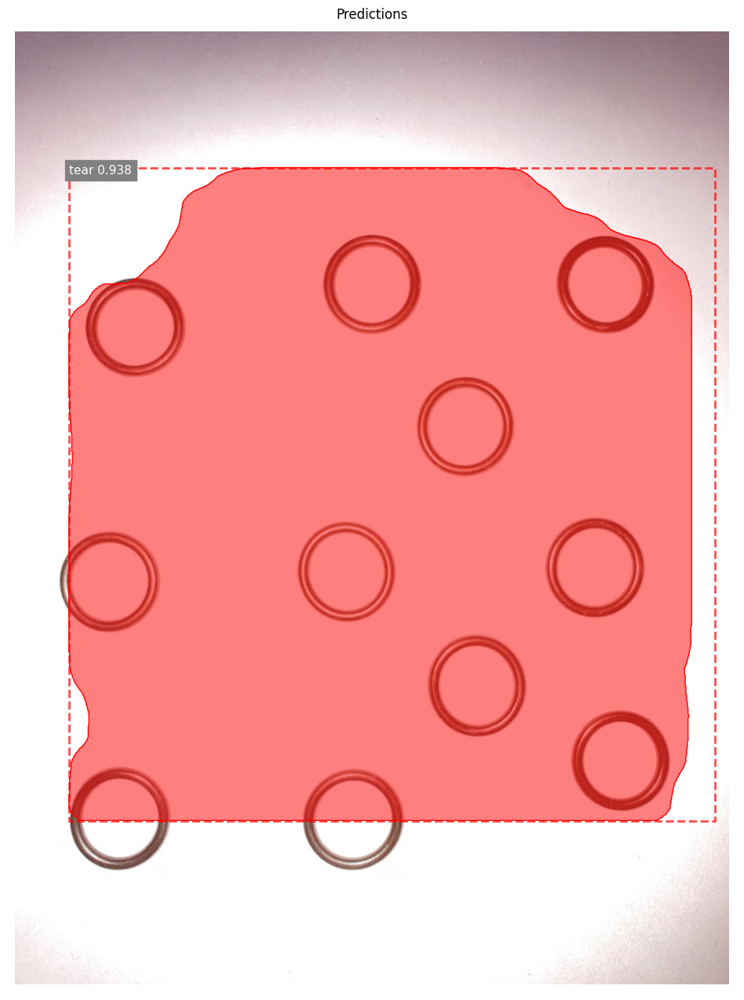

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0021.h5
Re-starting from epoch 21
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


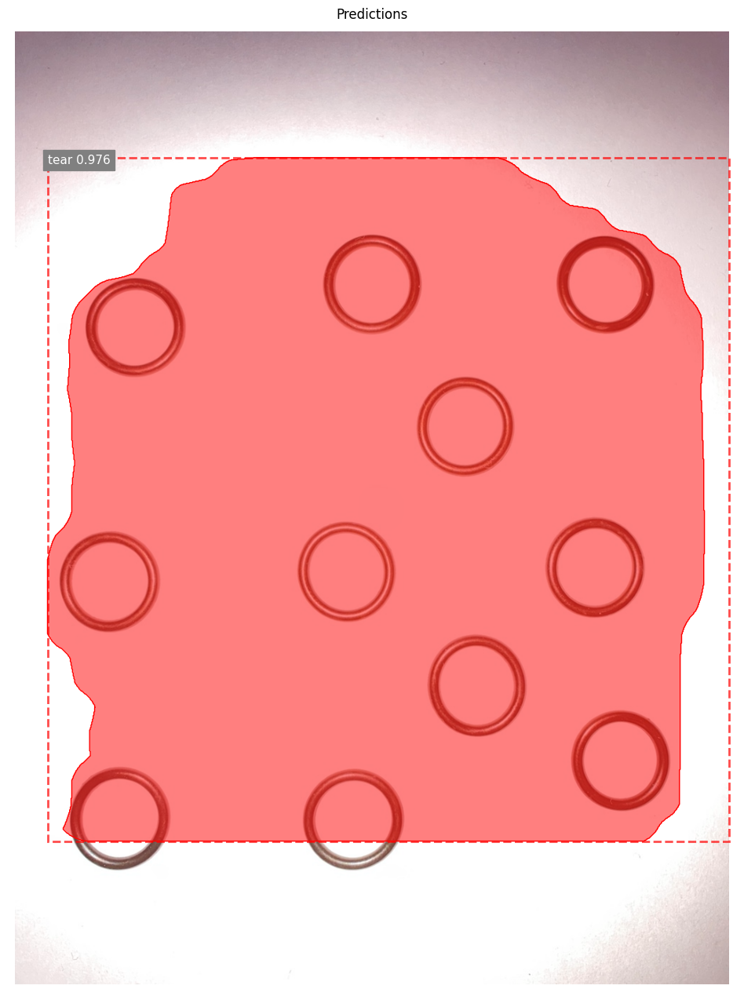

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0022.h5
Re-starting from epoch 22
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


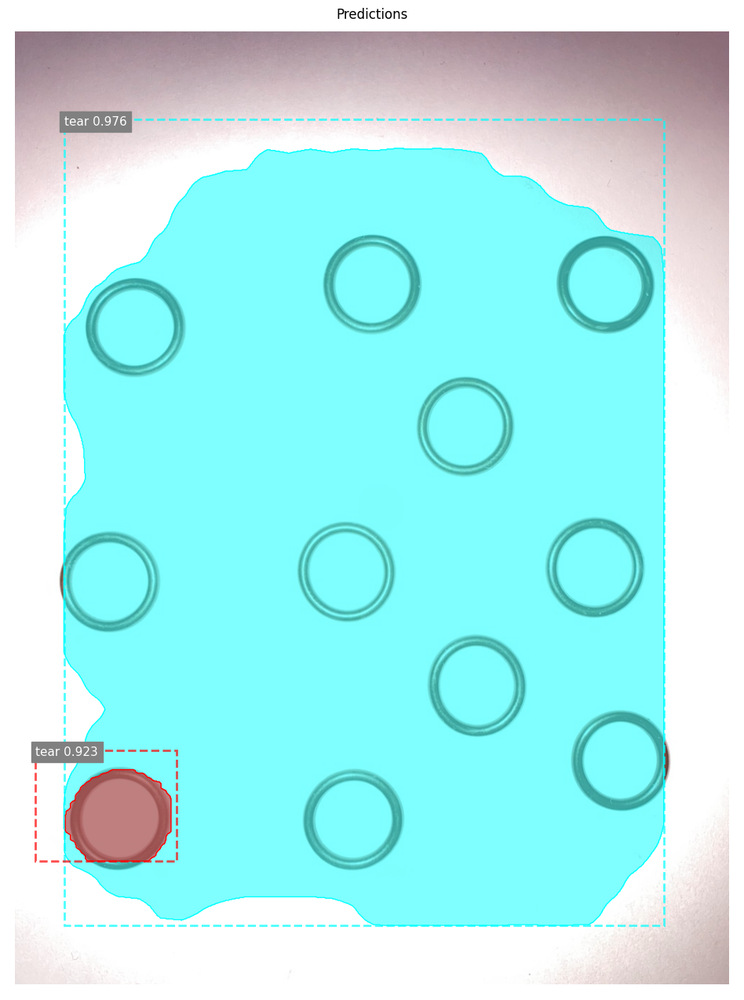

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0023.h5
Re-starting from epoch 23
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


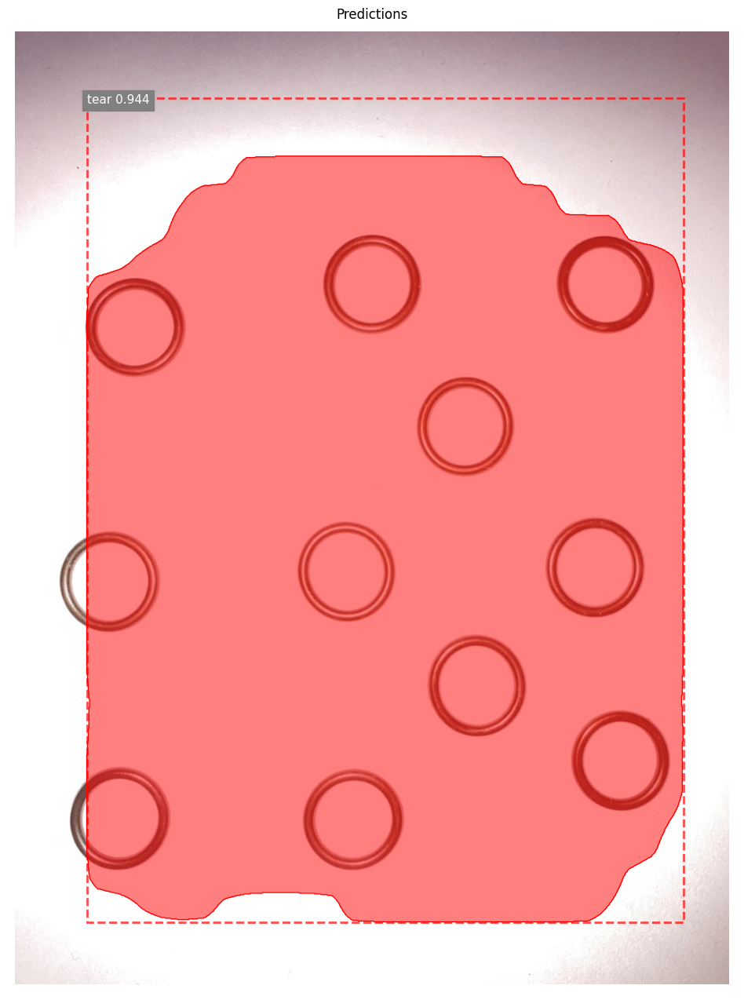

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0024.h5
Re-starting from epoch 24
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


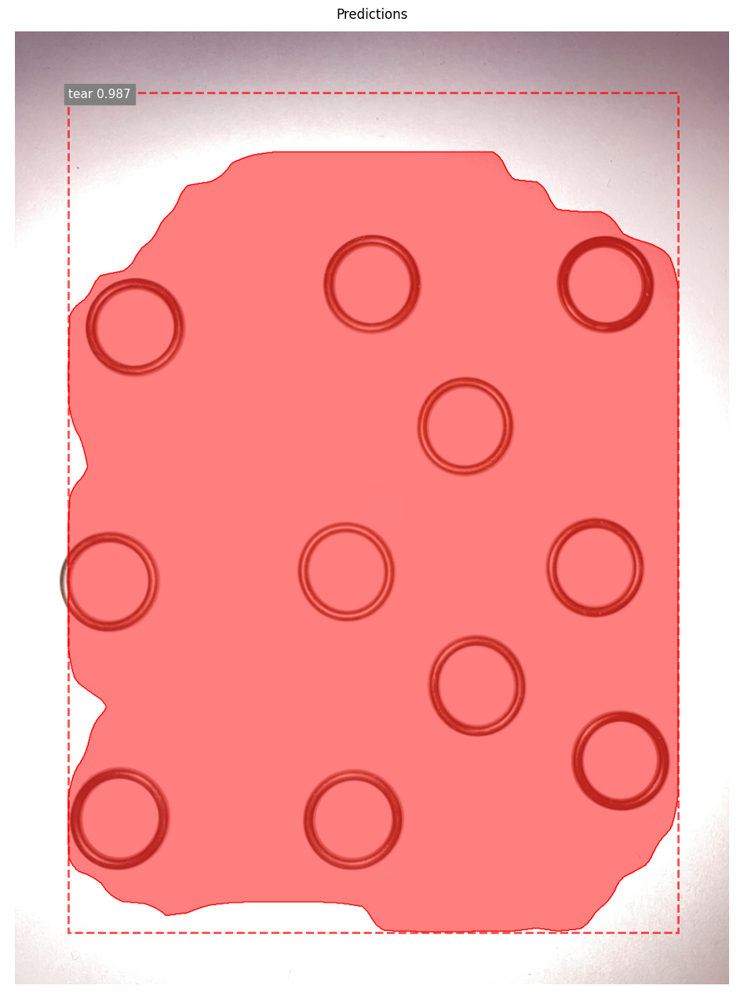

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0025.h5
Re-starting from epoch 25
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


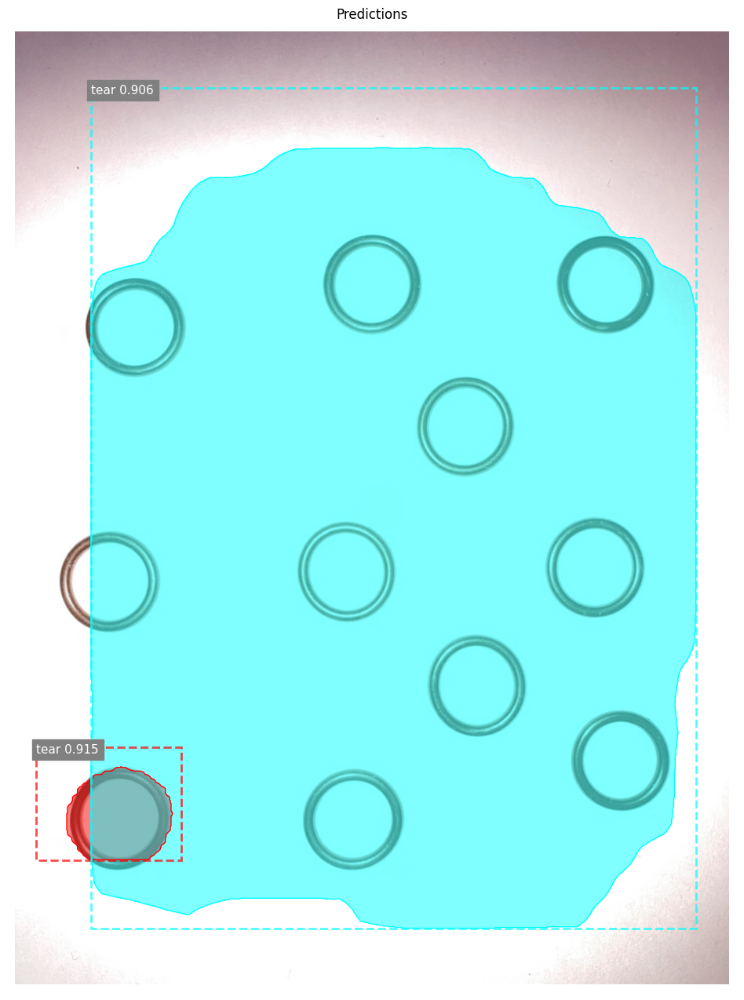

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0026.h5
Re-starting from epoch 26
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


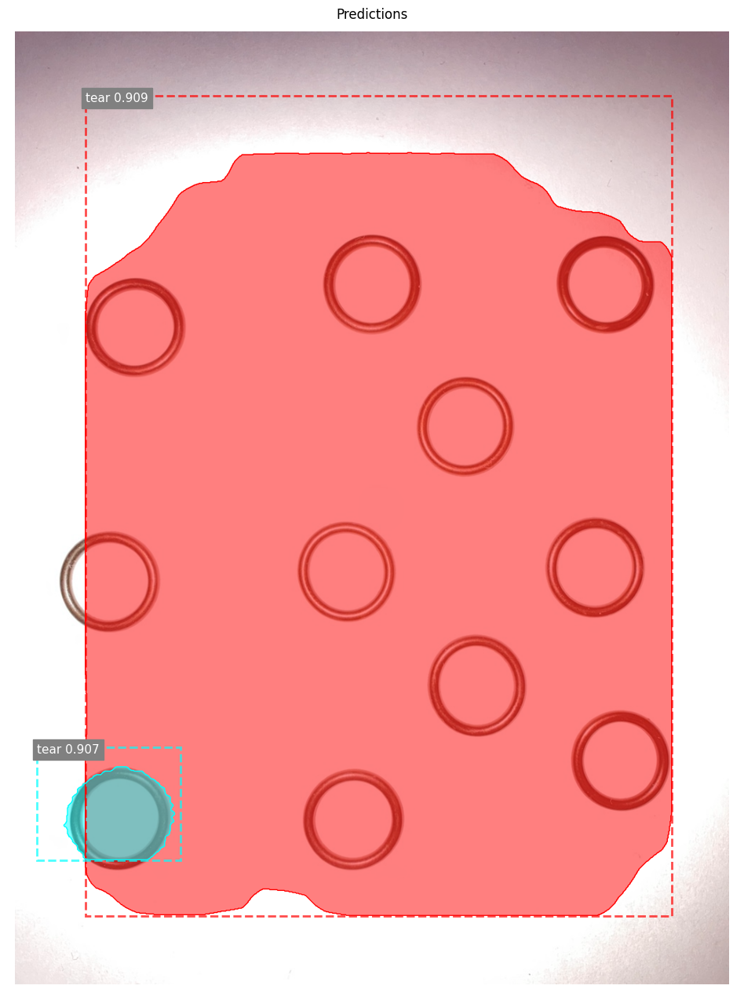

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0027.h5
Re-starting from epoch 27
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


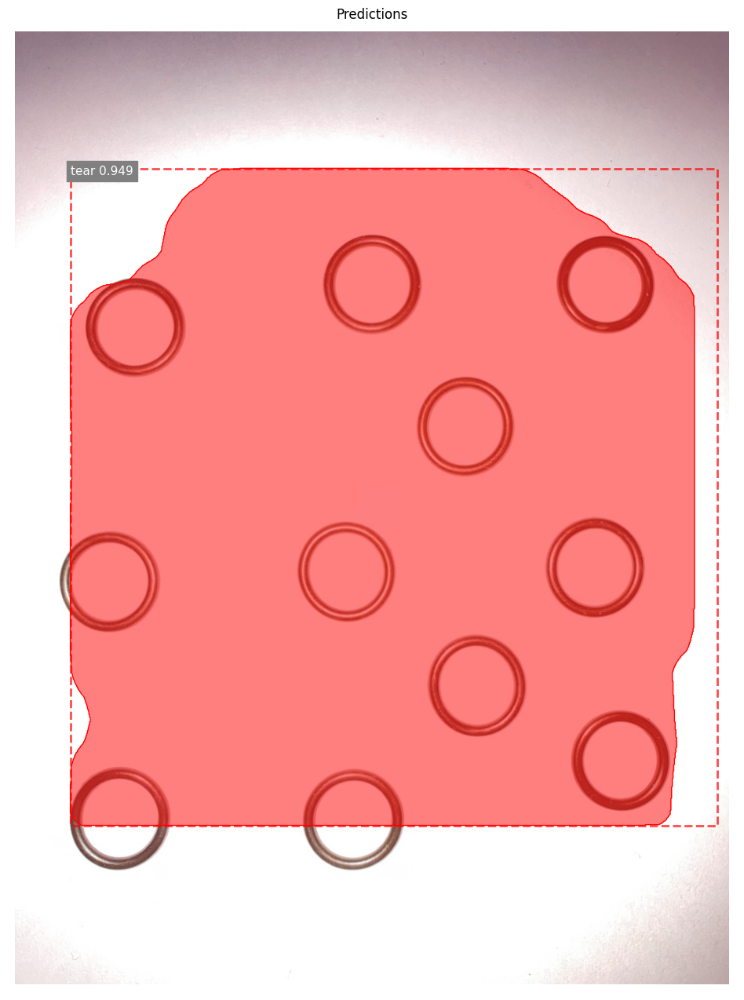

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0028.h5
Re-starting from epoch 28
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


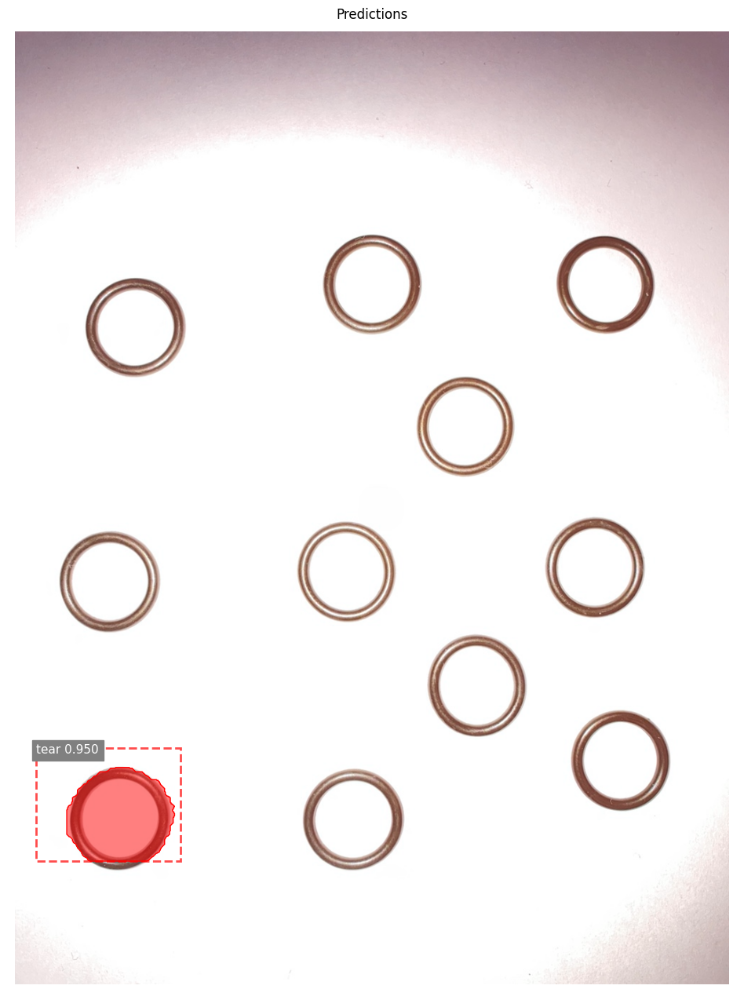

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0029.h5
Re-starting from epoch 29
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


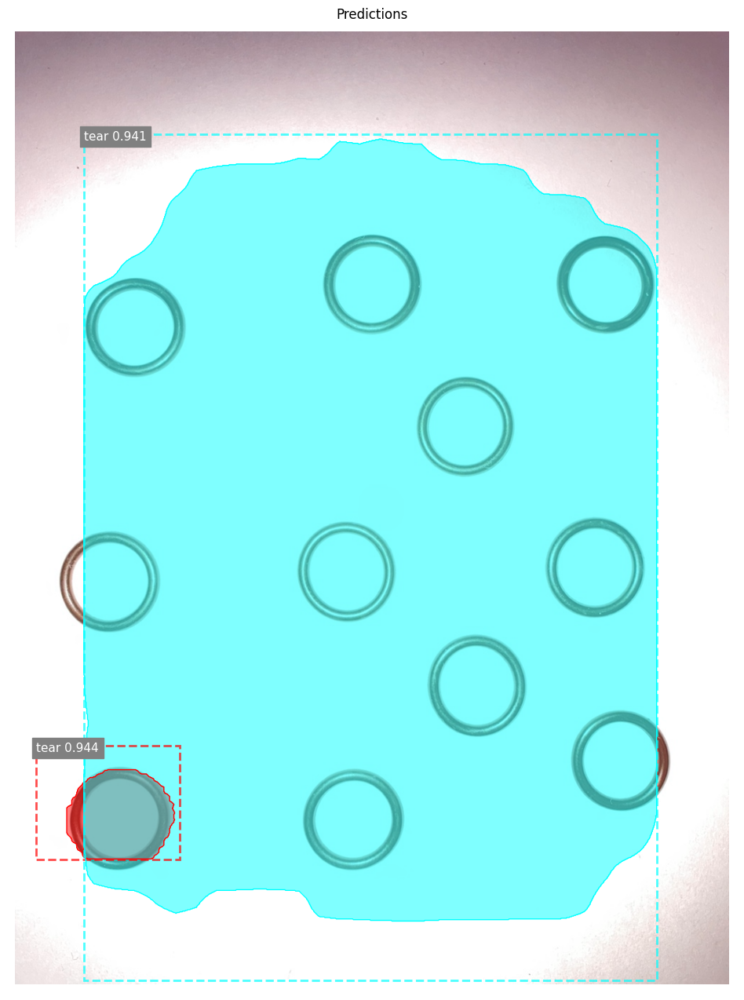

model weight path: C:/DEV/STUDY/maskrcnn/Mask_RCNN/weight/oring20221107T2346\mask_rcnn_oring_0030.h5
Re-starting from epoch 30
Processing 1 images
image                    shape: (1334, 1000, 3)       min:   40.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1334.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


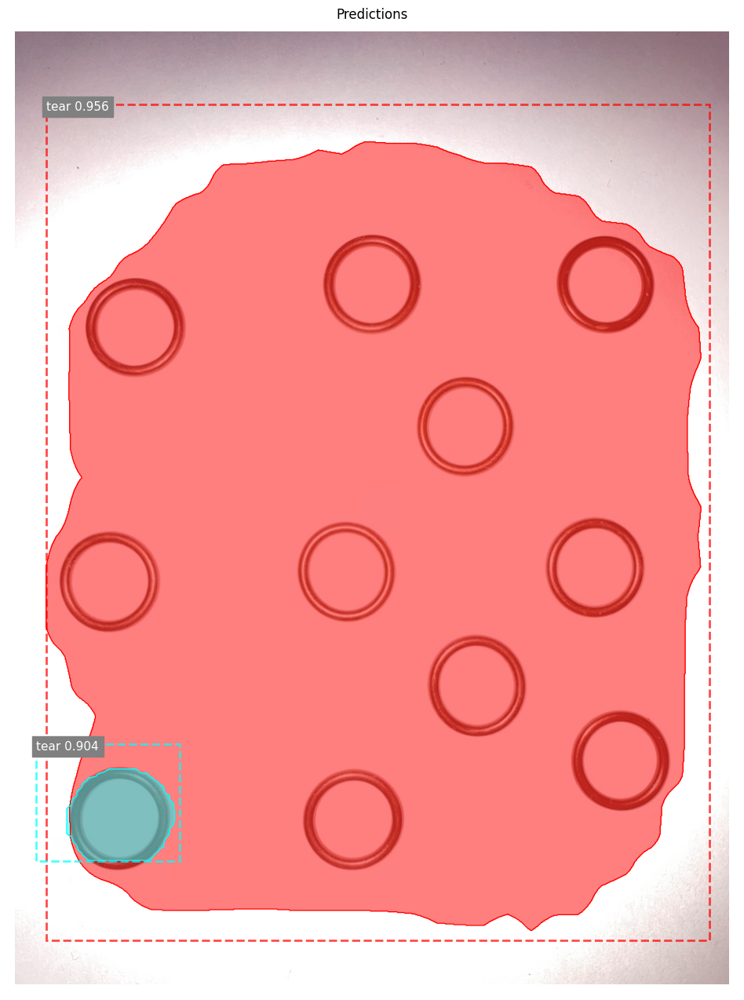

In [ ]:
for n in weight_list:
    start_time = time()
    # callback에 의해 model weights 가 파일로 생성되며, 가장 마지막에 생성된 weights 가 가장 적은 loss를 가지는 것으로 가정. 
    weights_path = n
    print('model weight path:', weights_path)
    # 지정된 weight 파일명으로 모델에 로딩. 
    model.load_weights(weights_path, by_name=True)
    
    test_image = cv2.imread('C:/DEV/STUDY/maskrcnn/test_data/KakaoTalk_20221109_212700099.jpg')
    results = model.detect([test_image])
    
    r = results[0]
    visualize.display_instances(test_image, r['rois'], r['masks'], r['class_ids'], 
                                dataset_val.class_names, r['scores'], 
                                title="Predictions")

In [ ]:
# 오링 여러개를 한꺼번에 인식시켰을 때, 오링이 제대로 인식되지 않음....
# Mask R-CNN의 경우 인식 전에 개별로 이미지를 잘라내는 전처리 과정이 필요할 것으로 보임

In [ ]:
# CAM 소스 받아서 인식시키기
capture = cv2.VideoCapture(0)

while True:
    ret, frame = capture.read()
    results = model.detect([frame], verbose=0)
    r = results[0]
    frame = visualize.display_instances(frame, r['rois'], r['masks'], r['class_ids'], 
                                dataset_val.class_names, r['scores'])
    cv2.imshow('frame', frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
        
capture.release()
cv2.destroyAllWindows()

AttributeError: 'NoneType' object has no attribute 'dtype'